## Exemplo de treinamento de uma GAN para CIFAR10

Demonstra como treinar uma GANs para o dataset MNIST utilizando a biblioteca GANLib

### 1 - Commit do repositorio para o github


In [1]:
# !git init
# !git add .
# !git remote add origin https://github.com/Jonlenes/MscProject.git

# !git add .
# !git commit -m "Separando em arquivos"
# !git push -u origin master

### 2 - Importações e verificações

#### 2.1 - Placa de video

In [2]:
!nvidia-smi

Wed Nov  7 02:31:17 2018       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 396.44                 Driver Version: 396.44                    |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  On   | 00000000:00:1B.0 Off |                    0 |
| N/A   54C    P0    69W / 300W |      0MiB / 16160MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-SXM2...  On   | 00000000:00:1C.0 Off |                    0 |
| N/A   45C    P0    64W / 300W |      0MiB / 16160MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   2  T

#### 2.2 - Imports

In [3]:
import numpy as np
from keras.datasets import cifar10

from keras.models import Sequential, Model
from keras.layers import Input, Dense, Reshape, Flatten, Dropout, ZeroPadding2D, Activation
from keras.layers import Conv2D, Conv2DTranspose, UpSampling2D
from keras.layers import LeakyReLU, Dropout
from keras.layers import BatchNormalization
from keras.optimizers import Adam, RMSprop

# Bilioteca desenvolvida
from GANLib.IDataset import IDataset
from GANLib.IDCGANModel import IDCGANModel
from GANLib.GANTrainer import GANTrainer

Using TensorFlow backend.


### 3 - Datasets

#### 3.1 - Dataset com os dados reais - Implementa IDataset

In [4]:
class CIFARDataset(IDataset):
    def __init__(self):
        super(CIFARDataset, self).__init__(height=32, width=32, channel=3)
    
    def load_data(self):
        print("Dowloand/Extract CIFAR10")
        (x_train, _), (_, _) = cifar10.load_data()
        x_train = x_train / 255.0
        # X_train = (X_train.astype(np.float32) - 127.5) / 127.5
        x_train = x_train.reshape(-1, self.height, self.width, self.channel)
        self.x_train = x_train
        print("Finished: ", x_train.shape)

#### 3.2 - Dataset com os dados de entrada do Generator - Implementa IDataset

In [5]:
class NoiseDataset(IDataset):
    def __init__(self):
        super(NoiseDataset, self).__init__()
    
    
    def load_data(self):
        pass
        
    
    def __len__(self): 
        return np.int64(99999999999)
        
    
    def nexts(self, lot_size):
        #return np.random.uniform(-1.0, 1.0, size=[lot_size, 100])
        return np.random.normal(0, 1, size=[lot_size, 100])

### 4 - Implementando o modelo 

In [6]:
class DCGANModel(IDCGANModel):
    def _build_new_discriminator(self):
        
        """
        input_shape=(28, 28, 1)
        depth = 64
        dropout = 0.4

        model = Sequential()

        model.add(Conv2D(depth*1, 5, strides=2, input_shape=input_shape, padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))

        model.add(Conv2D(depth*2, 5, strides=2, padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))

        model.add(Conv2D(depth*4, 5, strides=2, padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))

        model.add(Conv2D(depth*8, 5, strides=1, padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))

        # Out: 1-dim probability
        model.add(Flatten())
        model.add(Dense(1))
        model.add(Activation('sigmoid'))
        #model.summary()
        
        return model
        """
        img_shape=(32, 32, 3)
        input = Input(img_shape)
        x =Conv2D(32, kernel_size=3, strides=2, padding="same")(input)
        x = LeakyReLU(alpha=0.2)(x)
        x = Dropout(0.25)(x)
        x = Conv2D(64, kernel_size=3, strides=2, padding="same")(x)
        x = (LeakyReLU(alpha=0.2))(x)
        x = Dropout(0.25)(x)
        x = BatchNormalization(momentum=0.8)(x)
        x = Conv2D(128, kernel_size=3, strides=2, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = Dropout(0.25)(x)
        x = BatchNormalization(momentum=0.8)(x)
        x = Conv2D(256, kernel_size=3, strides=1, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = Dropout(0.25)(x)
        x = Flatten()(x)
        out = Dense(1, activation='sigmoid')(x)

        model = Model(input, out)
        print("-- Discriminator -- ")
        model.summary()
        return model

    
    def _build_new_generator(self):
        """
        dropout = 0.4
        depth = 64+64+64+64
        dim = 7
        # In: 100
        # Out: dim x dim x depth
        model = Sequential()
        
        model.add(Dense(dim*dim*depth, input_dim=100))
        model.add(BatchNormalization(momentum=0.9))
        model.add(Activation('relu'))
        model.add(Reshape((dim, dim, depth)))
        model.add(Dropout(dropout))

        # In: dim x dim x depth
        # Out: 2*dim x 2*dim x depth/2
        model.add(UpSampling2D())
        model.add(Conv2DTranspose(int(depth/2), 5, padding='same'))
        model.add(BatchNormalization(momentum=0.9))
        model.add(Activation('relu'))

        model.add(UpSampling2D())
        model.add(Conv2DTranspose(int(depth/4), 5, padding='same'))
        model.add(BatchNormalization(momentum=0.9))
        model.add(Activation('relu'))

        model.add(Conv2DTranspose(int(depth/8), 5, padding='same'))
        model.add(BatchNormalization(momentum=0.9))
        model.add(Activation('relu'))

        # Out: 28 x 28 x 1 grayscale image [0.0,1.0] per pix
        model.add(Conv2DTranspose(1, 5, padding='same'))
        model.add(Activation('sigmoid'))
        #model.summary()

        return model
        """
        noise_shape=(100,)
        input = Input(noise_shape)
        x = Dense(128 * 8 * 8, activation="relu")(input)
        x = Reshape((8, 8, 128))(x)
        x = BatchNormalization(momentum=0.8)(x)
        x = UpSampling2D()(x)
        x = Conv2D(128, kernel_size=3, padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(momentum=0.8)(x)
        x = UpSampling2D()(x)
        x = Conv2D(64, kernel_size=3, padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(momentum=0.8)(x)
        x = Conv2D(3, kernel_size=3, padding="same")(x)
        out = Activation("tanh")(x)
        model = Model(input, out)
        print("-- Generator -- ")
        model.summary()
        return model


### 5 - Treinamento

-- Discriminator -- 
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 32)        896       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 64)          18496     
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 64)          0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 8, 8, 64)          

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1563/1562 [==============================] - 39s 25ms/step
Time 38.65 sec  - [D loss: 0.55, acc.: 72.40%] [G loss: 0.91]


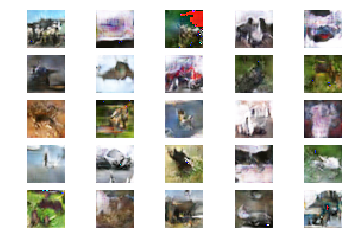

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 27 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.86 sec  - [D loss: 0.59, acc.: 61.25%] [G loss: 1.09]


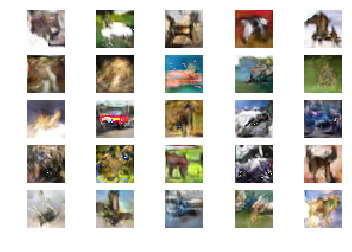

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 28 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.74 sec  - [D loss: 0.62, acc.: 59.69%] [G loss: 0.88]


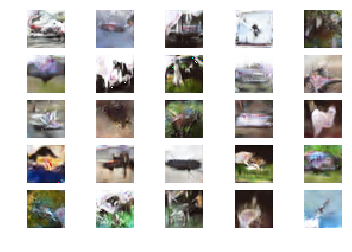

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 29 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.82 sec  - [D loss: 0.63, acc.: 67.71%] [G loss: 0.93]


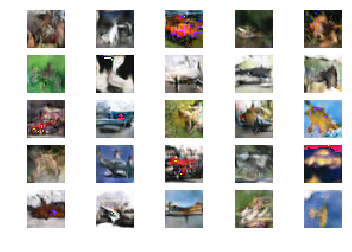

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 30 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.73 sec  - [D loss: 0.55, acc.: 72.81%] [G loss: 0.87]
Image grid result save.


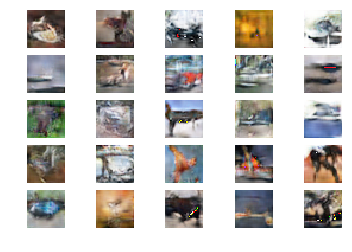

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 31 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.72 sec  - [D loss: 0.61, acc.: 60.31%] [G loss: 0.90]


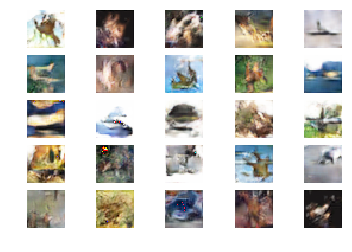

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 32 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.72 sec  - [D loss: 0.62, acc.: 66.15%] [G loss: 0.92]


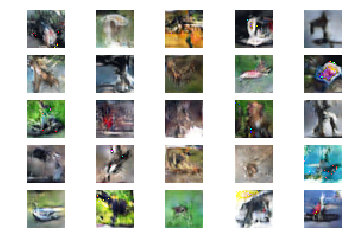

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 33 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.79 sec  - [D loss: 0.62, acc.: 59.69%] [G loss: 0.92]


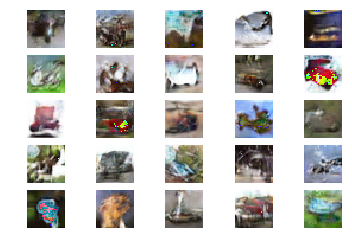

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 34 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.63 sec  - [D loss: 0.67, acc.: 64.58%] [G loss: 0.95]


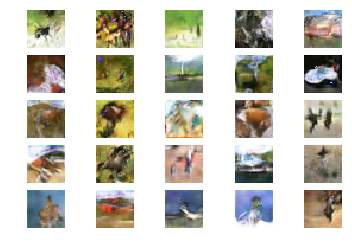

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 35 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.61 sec  - [D loss: 0.57, acc.: 64.79%] [G loss: 0.90]


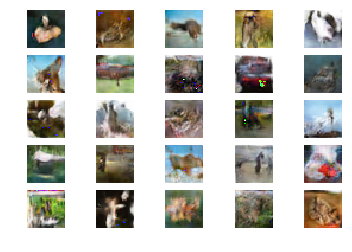

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 36 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.7 sec  - [D loss: 0.64, acc.: 79.06%] [G loss: 1.02]


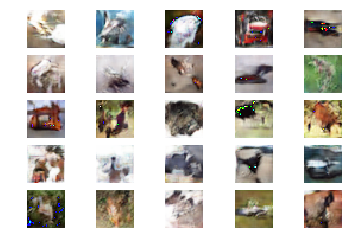

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 37 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.7 sec  - [D loss: 0.81, acc.: 48.54%] [G loss: 0.88]


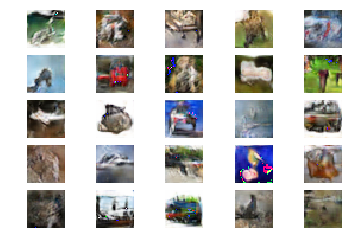

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 38 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.64 sec  - [D loss: 0.56, acc.: 74.79%] [G loss: 0.95]


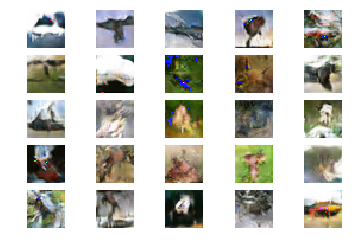

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 39 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.63 sec  - [D loss: 0.66, acc.: 65.94%] [G loss: 0.89]


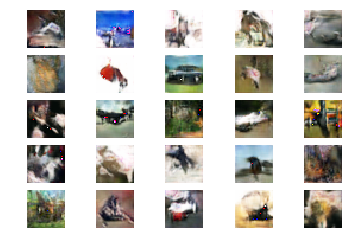

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 40 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.69 sec  - [D loss: 0.56, acc.: 74.37%] [G loss: 1.04]
Image grid result save.


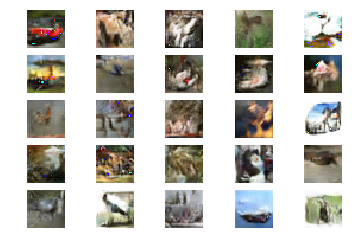

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 41 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.6 sec  - [D loss: 0.79, acc.: 43.02%] [G loss: 1.06]


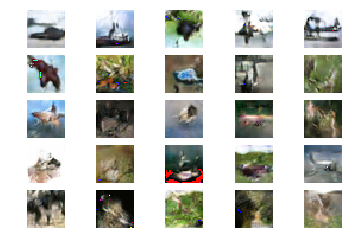

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 42 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.67 sec  - [D loss: 0.73, acc.: 54.37%] [G loss: 0.99]


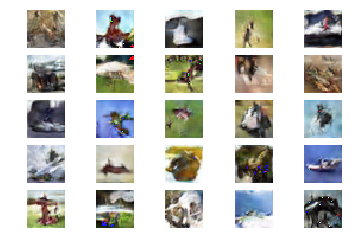

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 43 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.58 sec  - [D loss: 0.70, acc.: 56.77%] [G loss: 0.99]


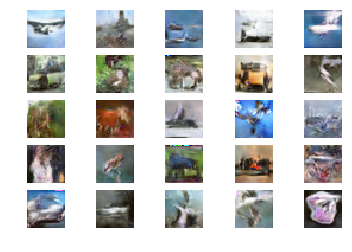

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 44 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.62 sec  - [D loss: 0.67, acc.: 63.23%] [G loss: 0.92]


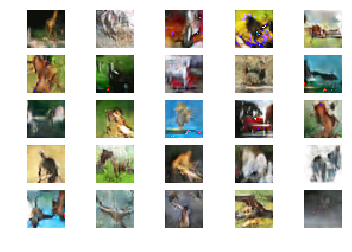

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 45 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.62 sec  - [D loss: 0.82, acc.: 41.87%] [G loss: 0.98]


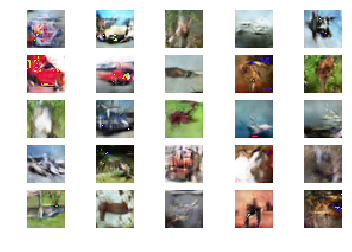

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 46 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.81 sec  - [D loss: 0.69, acc.: 56.35%] [G loss: 0.95]


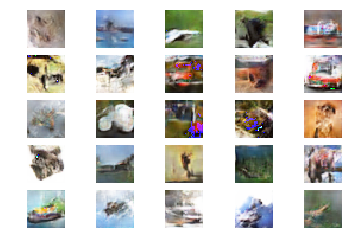

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 47 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.76 sec  - [D loss: 0.61, acc.: 66.56%] [G loss: 0.87]


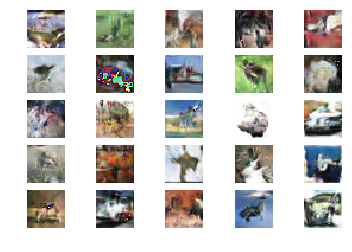

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 48 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.67 sec  - [D loss: 0.75, acc.: 41.67%] [G loss: 1.11]


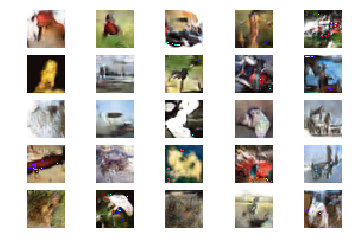

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 49 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.95 sec  - [D loss: 0.67, acc.: 58.13%] [G loss: 0.98]


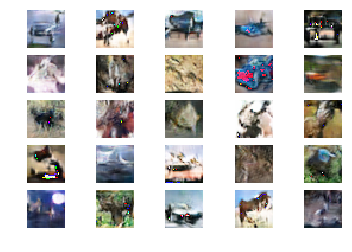

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 50 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.89 sec  - [D loss: 0.61, acc.: 67.50%] [G loss: 0.99]
Image grid result save.


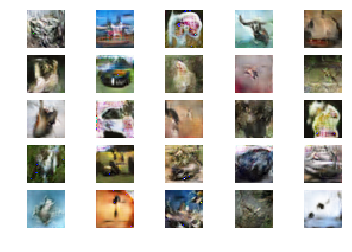

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 51 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.82 sec  - [D loss: 0.75, acc.: 48.33%] [G loss: 0.93]


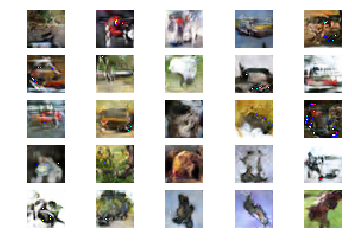

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 52 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.76 sec  - [D loss: 0.59, acc.: 69.27%] [G loss: 0.93]


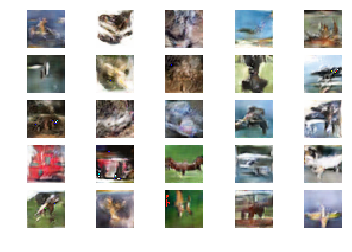

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 53 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.79 sec  - [D loss: 0.68, acc.: 65.73%] [G loss: 0.95]


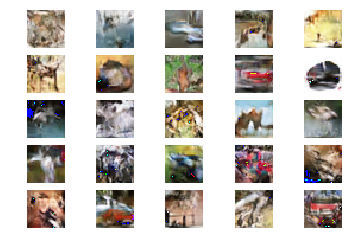

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 54 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.94 sec  - [D loss: 0.57, acc.: 70.83%] [G loss: 1.06]


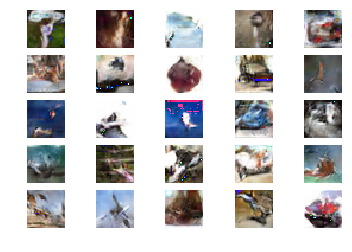

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 55 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.88 sec  - [D loss: 0.66, acc.: 61.25%] [G loss: 0.94]


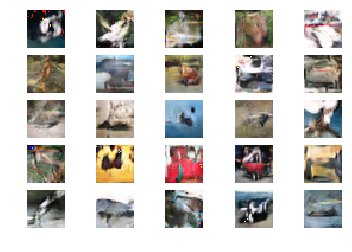

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 56 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.69 sec  - [D loss: 0.60, acc.: 60.62%] [G loss: 0.87]


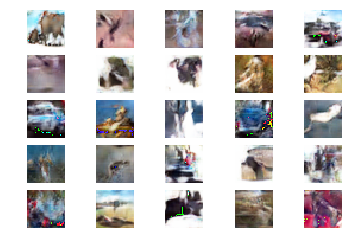

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 57 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.55 sec  - [D loss: 0.68, acc.: 50.10%] [G loss: 0.99]


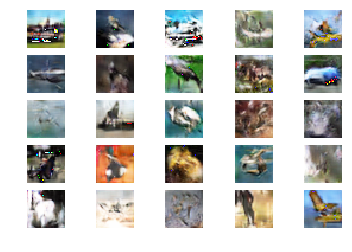

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 58 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.59 sec  - [D loss: 0.63, acc.: 67.50%] [G loss: 0.83]


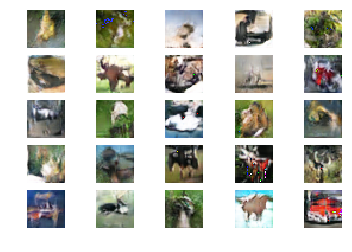

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 59 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.65 sec  - [D loss: 0.84, acc.: 38.12%] [G loss: 1.05]


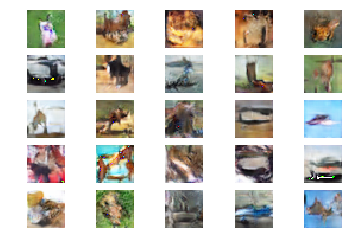

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 60 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.7 sec  - [D loss: 0.68, acc.: 59.69%] [G loss: 1.06]
Image grid result save.


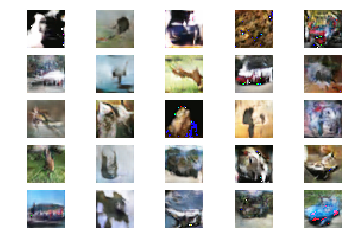

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 61 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.61 sec  - [D loss: 0.71, acc.: 43.65%] [G loss: 0.94]


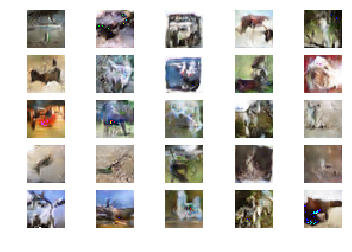

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 62 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.52 sec  - [D loss: 0.50, acc.: 85.52%] [G loss: 0.89]


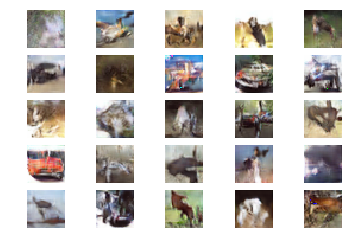

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 63 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.67 sec  - [D loss: 0.68, acc.: 57.71%] [G loss: 1.02]


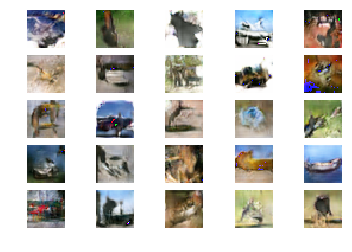

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 64 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.7 sec  - [D loss: 0.63, acc.: 64.58%] [G loss: 0.95]


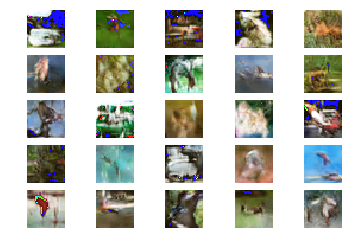

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 65 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.67 sec  - [D loss: 0.64, acc.: 69.06%] [G loss: 0.90]


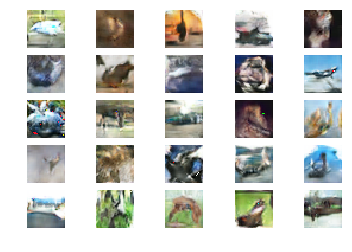

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 66 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.59 sec  - [D loss: 0.69, acc.: 66.15%] [G loss: 0.87]


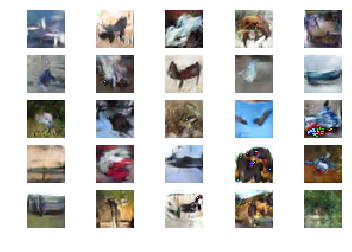

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 67 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.63, acc.: 56.15%] [G loss: 0.87]


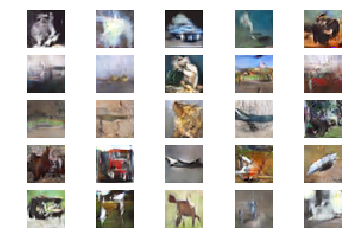

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 68 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.54 sec  - [D loss: 0.57, acc.: 69.69%] [G loss: 0.83]


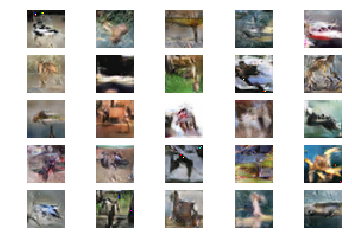

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 69 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.66, acc.: 61.25%] [G loss: 0.89]


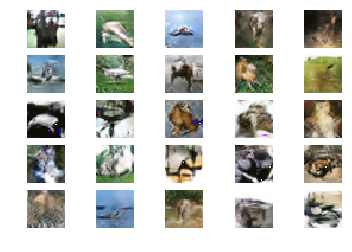

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 70 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.66, acc.: 56.77%] [G loss: 0.99]
Image grid result save.


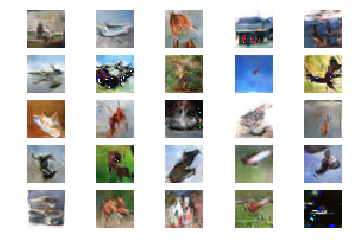

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 71 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.75, acc.: 51.67%] [G loss: 0.85]


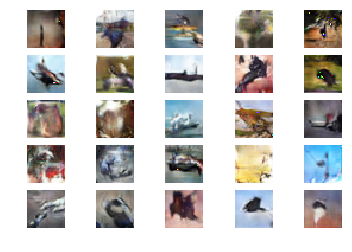

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 72 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.62, acc.: 64.58%] [G loss: 0.99]


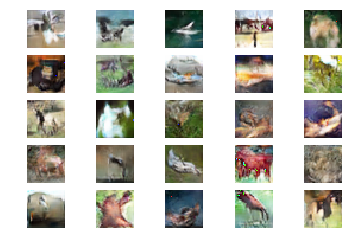

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 73 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.64, acc.: 66.35%] [G loss: 0.83]


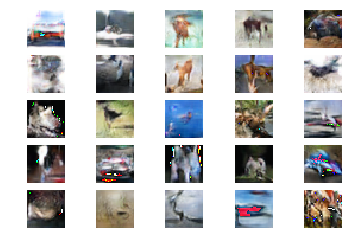

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 74 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.64, acc.: 69.48%] [G loss: 0.73]


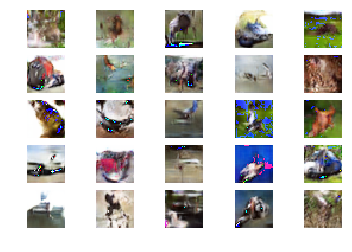

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 75 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.67, acc.: 68.12%] [G loss: 1.05]


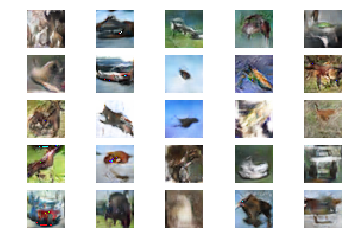

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 76 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.61, acc.: 64.38%] [G loss: 0.85]


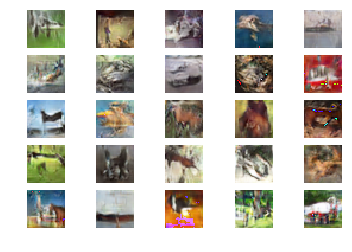

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 77 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.63, acc.: 67.92%] [G loss: 1.18]


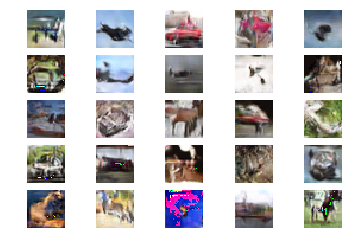

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 78 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.80, acc.: 53.02%] [G loss: 0.90]


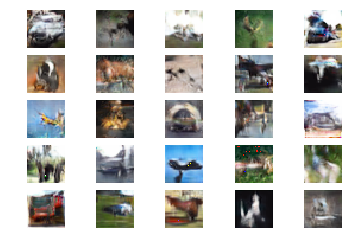

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 79 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.59, acc.: 67.50%] [G loss: 0.86]


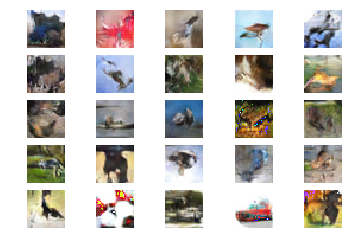

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 80 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.61, acc.: 67.92%] [G loss: 1.00]
Image grid result save.


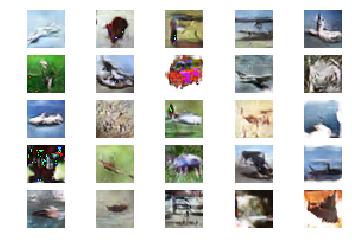

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 81 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.61, acc.: 68.12%] [G loss: 0.90]


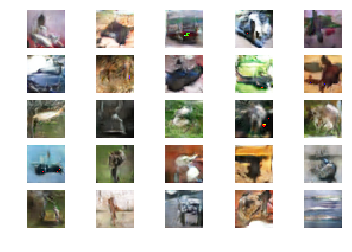

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 82 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.60, acc.: 61.46%] [G loss: 0.95]


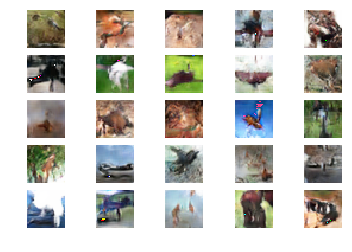

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 83 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.64, acc.: 61.67%] [G loss: 0.81]


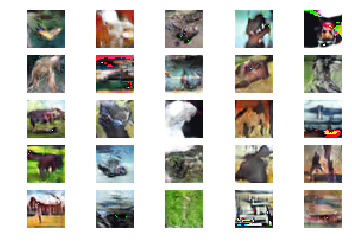

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 84 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.69, acc.: 58.13%] [G loss: 0.90]


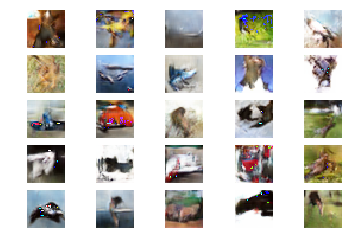

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 85 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.62, acc.: 66.35%] [G loss: 0.76]


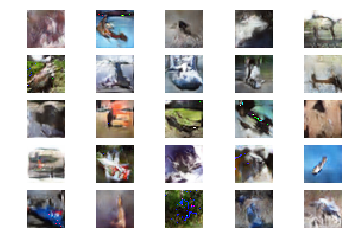

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 86 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.68 sec  - [D loss: 0.55, acc.: 79.06%] [G loss: 0.83]


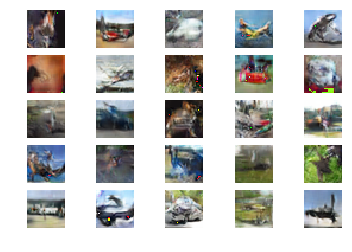

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 87 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.64 sec  - [D loss: 0.68, acc.: 59.69%] [G loss: 0.98]


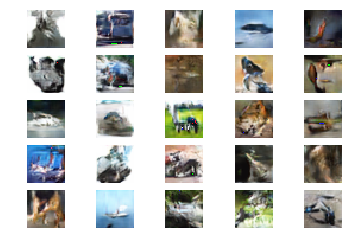

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 88 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.56 sec  - [D loss: 0.53, acc.: 79.06%] [G loss: 0.77]


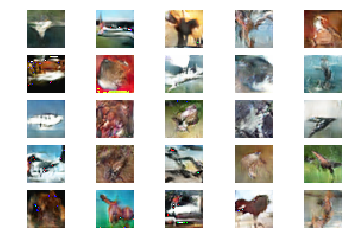

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 89 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.56, acc.: 77.71%] [G loss: 0.87]


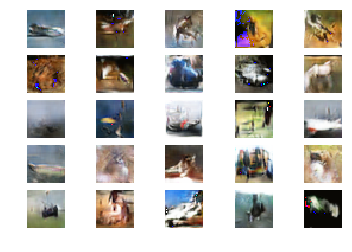

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 90 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.65, acc.: 58.13%] [G loss: 0.93]
Image grid result save.


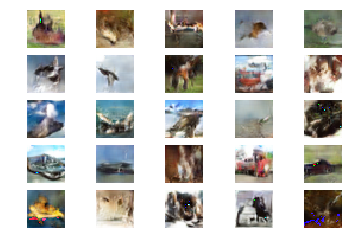

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 91 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.62 sec  - [D loss: 0.55, acc.: 74.79%] [G loss: 0.88]


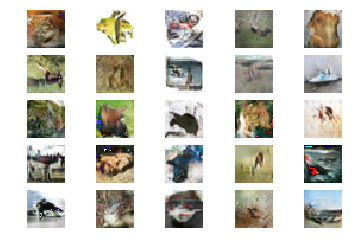

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 92 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.68 sec  - [D loss: 0.68, acc.: 59.48%] [G loss: 0.87]


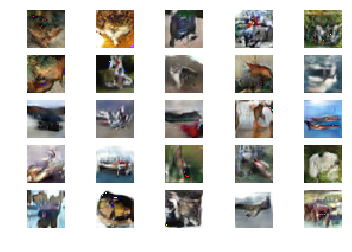

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 93 of 500000
1563/1562 [==============================] - 34s 22ms/step
Time 33.65 sec  - [D loss: 0.64, acc.: 66.77%] [G loss: 1.11]


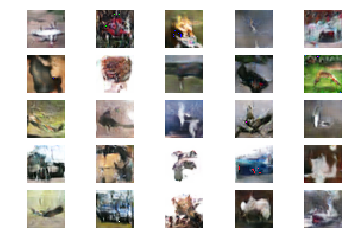

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 94 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.60, acc.: 67.92%] [G loss: 0.84]


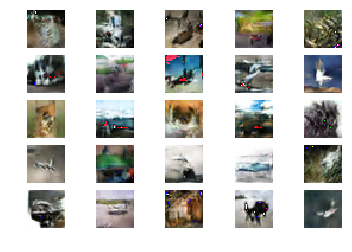

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 95 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.56 sec  - [D loss: 0.70, acc.: 54.58%] [G loss: 0.98]


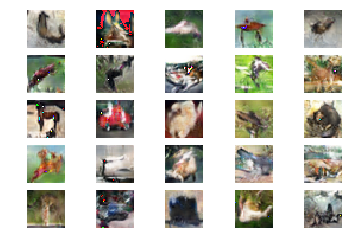

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 96 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.52 sec  - [D loss: 0.54, acc.: 77.50%] [G loss: 0.93]


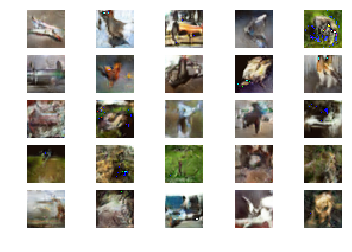

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 97 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.69, acc.: 61.04%] [G loss: 0.88]


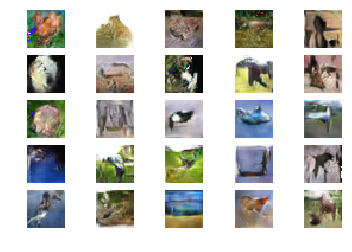

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 98 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.61, acc.: 74.37%] [G loss: 0.96]


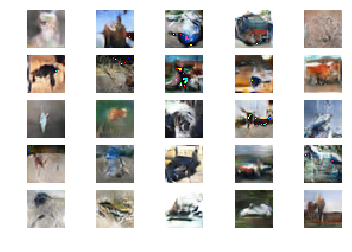

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 99 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.56, acc.: 73.96%] [G loss: 0.81]


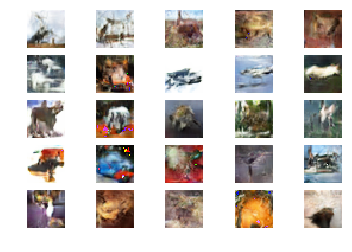

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 100 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.58 sec  - [D loss: 0.65, acc.: 64.79%] [G loss: 0.90]
Image grid result save.


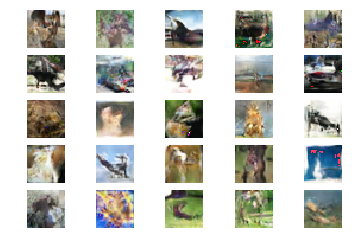

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 101 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.55 sec  - [D loss: 0.60, acc.: 59.90%] [G loss: 0.98]


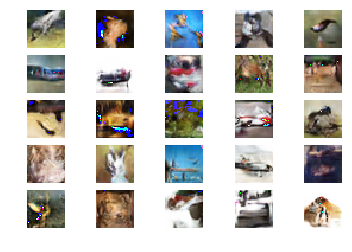

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 102 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.56 sec  - [D loss: 0.59, acc.: 71.04%] [G loss: 0.99]


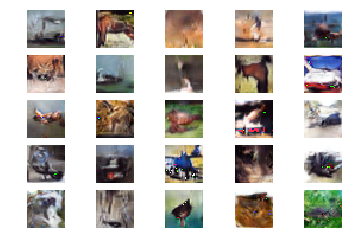

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 103 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.64, acc.: 61.25%] [G loss: 1.02]


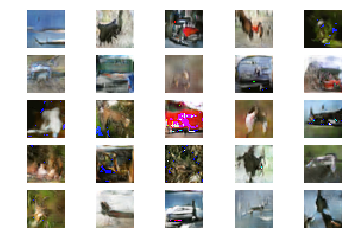

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 104 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.70, acc.: 63.02%] [G loss: 0.94]


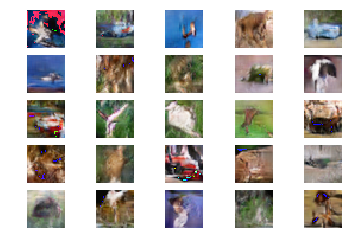

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 105 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.57, acc.: 75.94%] [G loss: 0.99]


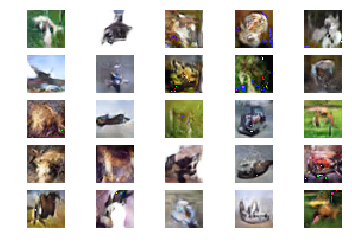

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 106 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.76, acc.: 46.77%] [G loss: 1.07]


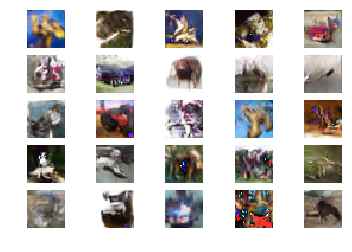

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 107 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.66, acc.: 62.60%] [G loss: 0.96]


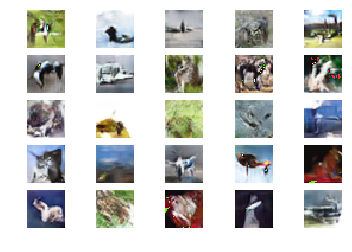

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 108 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.65, acc.: 63.23%] [G loss: 1.01]


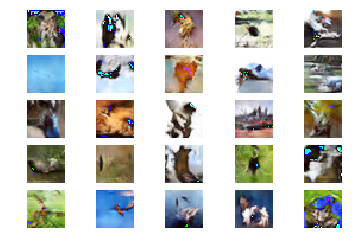

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 109 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.56, acc.: 79.27%] [G loss: 0.90]


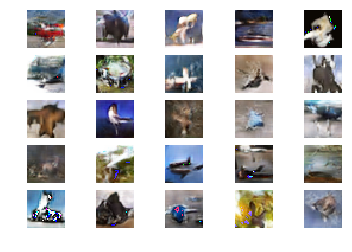

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 110 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.63, acc.: 65.94%] [G loss: 0.93]
Image grid result save.


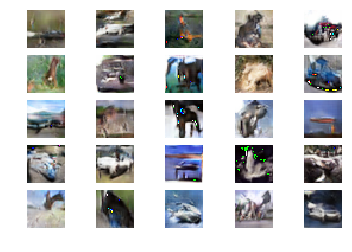

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 111 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.61 sec  - [D loss: 0.63, acc.: 73.23%] [G loss: 0.86]


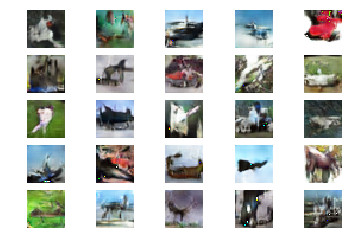

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 112 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.62, acc.: 62.81%] [G loss: 1.00]


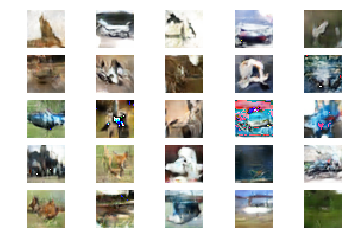

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 113 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.68, acc.: 53.23%] [G loss: 0.85]


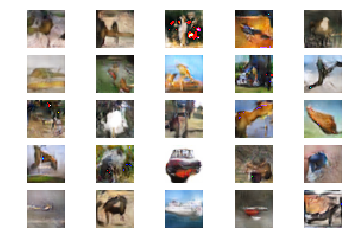

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 114 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.56, acc.: 71.04%] [G loss: 0.93]


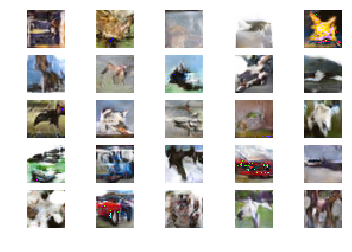

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 115 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.58, acc.: 68.12%] [G loss: 0.94]


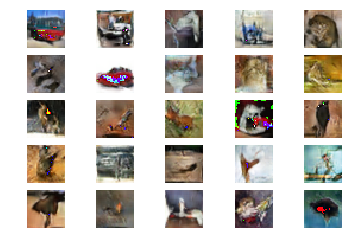

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 116 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.66, acc.: 60.83%] [G loss: 0.90]


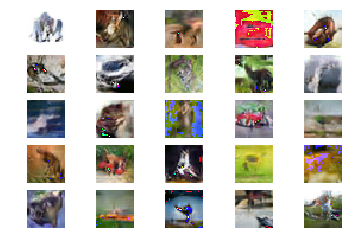

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 117 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.73, acc.: 63.02%] [G loss: 0.98]


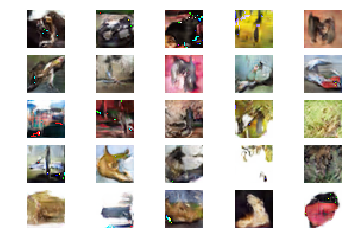

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 118 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.68, acc.: 53.23%] [G loss: 0.88]


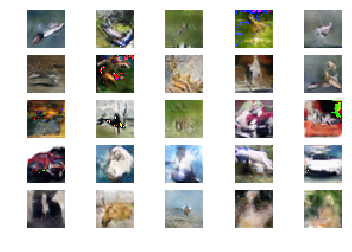

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 119 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.52 sec  - [D loss: 0.56, acc.: 74.37%] [G loss: 0.87]


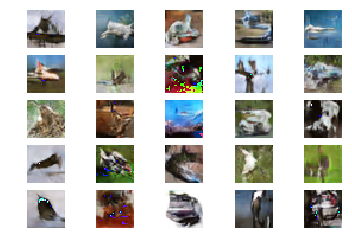

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 120 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.59 sec  - [D loss: 0.62, acc.: 72.60%] [G loss: 0.97]
Image grid result save.


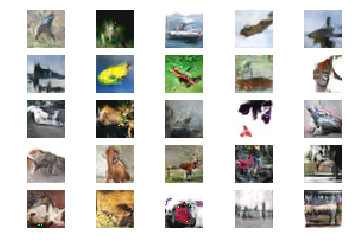

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 121 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.49, acc.: 82.19%] [G loss: 0.72]


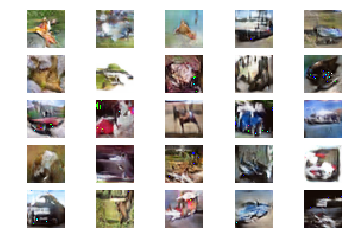

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 122 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.60, acc.: 63.02%] [G loss: 1.02]


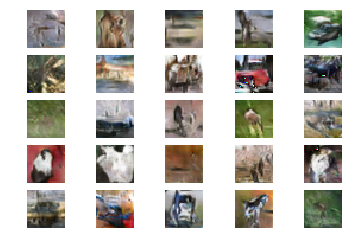

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 123 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.59 sec  - [D loss: 0.55, acc.: 74.37%] [G loss: 0.92]


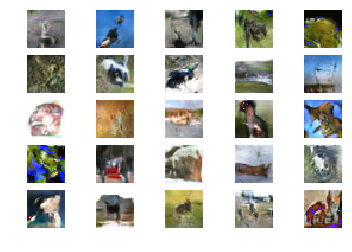

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 124 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.72, acc.: 51.67%] [G loss: 0.94]


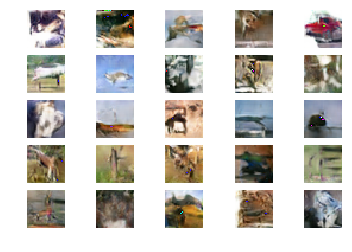

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 125 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.58 sec  - [D loss: 0.61, acc.: 72.81%] [G loss: 0.96]


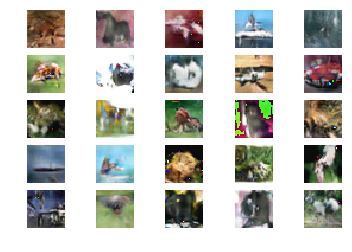

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 126 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.54, acc.: 77.92%] [G loss: 0.82]


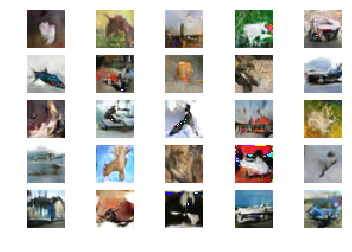

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 127 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.49, acc.: 87.29%] [G loss: 0.97]


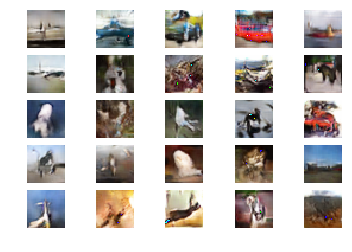

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 128 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.59, acc.: 74.58%] [G loss: 1.05]


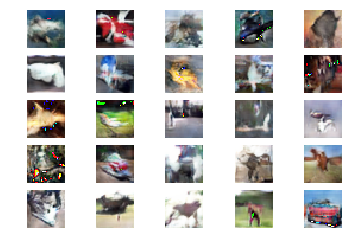

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 129 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.76, acc.: 58.33%] [G loss: 0.90]


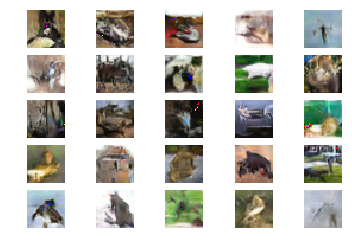

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 130 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.56, acc.: 72.60%] [G loss: 1.07]
Image grid result save.


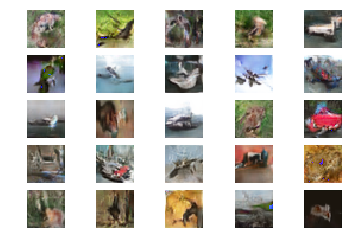

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 131 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.65, acc.: 71.04%] [G loss: 1.02]


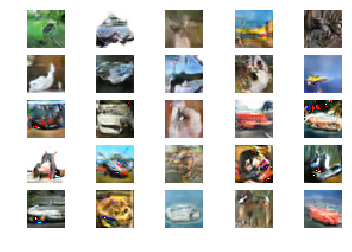

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 132 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.56, acc.: 77.29%] [G loss: 1.02]


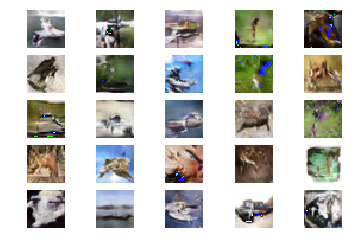

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 133 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.55, acc.: 74.37%] [G loss: 0.96]


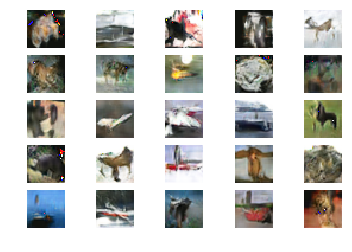

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 134 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.60, acc.: 76.15%] [G loss: 0.87]


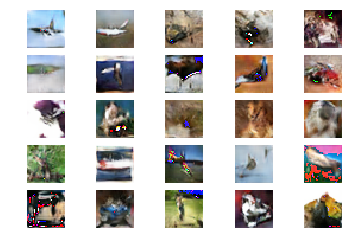

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 135 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.63, acc.: 69.90%] [G loss: 0.98]


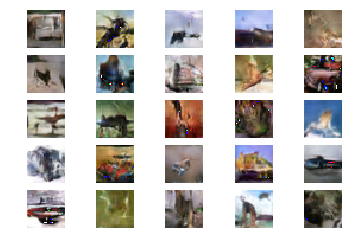

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 136 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.66, acc.: 56.15%] [G loss: 0.93]


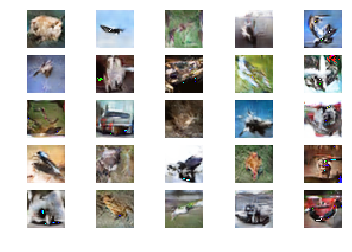

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 137 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.62 sec  - [D loss: 0.59, acc.: 71.04%] [G loss: 0.90]


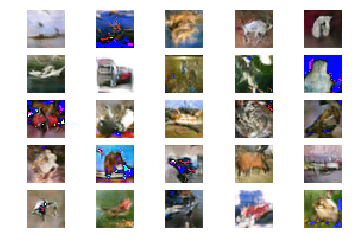

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 138 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.66, acc.: 64.38%] [G loss: 0.88]


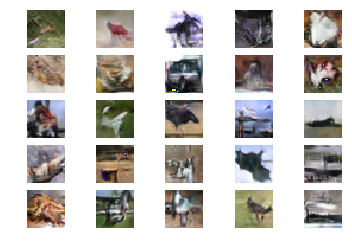

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 139 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.63, acc.: 63.44%] [G loss: 1.14]


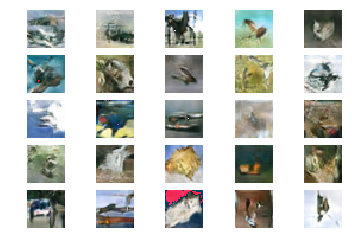

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 140 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.59, acc.: 74.79%] [G loss: 0.93]
Image grid result save.


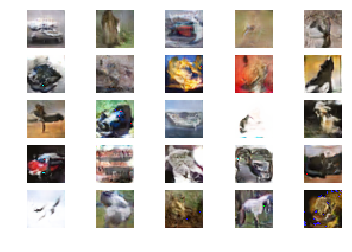

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 141 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.65, acc.: 54.79%] [G loss: 0.93]


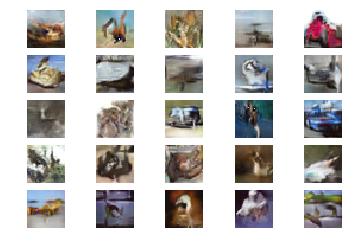

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 142 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.59, acc.: 71.46%] [G loss: 0.85]


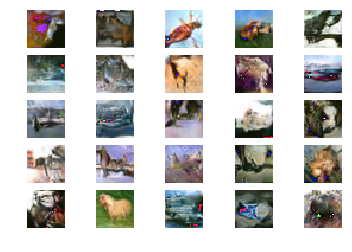

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 143 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.58, acc.: 69.69%] [G loss: 0.85]


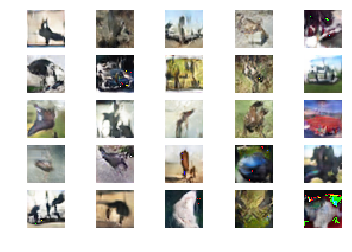

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 144 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.57, acc.: 67.71%] [G loss: 0.90]


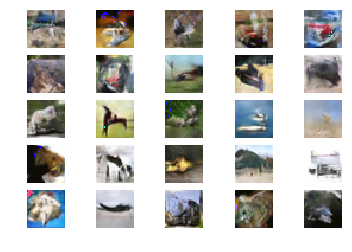

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 145 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.57, acc.: 72.60%] [G loss: 0.91]


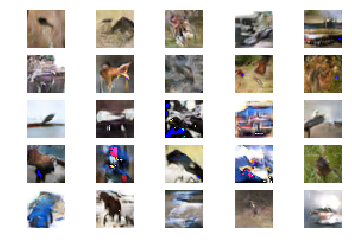

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 146 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.66, acc.: 56.35%] [G loss: 0.97]


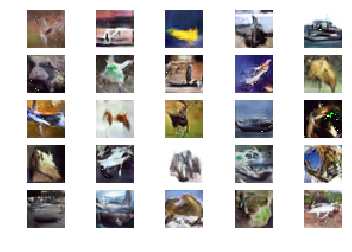

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 147 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.61, acc.: 71.04%] [G loss: 0.86]


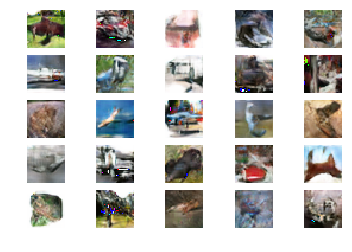

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 148 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.63, acc.: 61.67%] [G loss: 0.83]


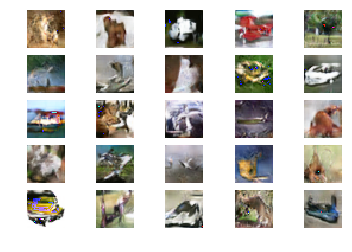

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 149 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.61, acc.: 73.02%] [G loss: 0.93]


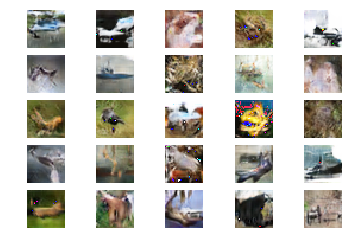

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 150 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.62, acc.: 63.44%] [G loss: 0.92]
Image grid result save.


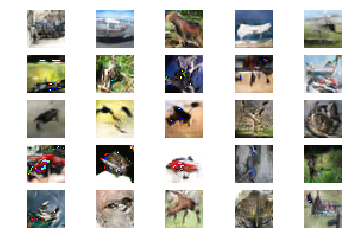

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 151 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.63, acc.: 60.10%] [G loss: 0.82]


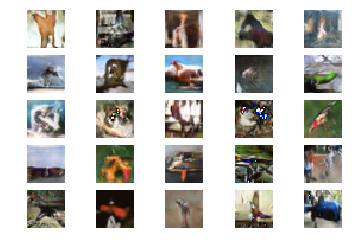

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 152 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.62, acc.: 64.79%] [G loss: 0.82]


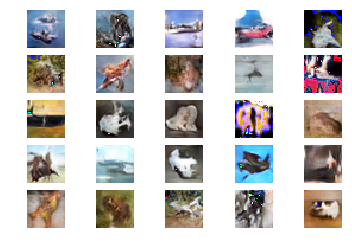

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 153 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.72, acc.: 51.67%] [G loss: 0.80]


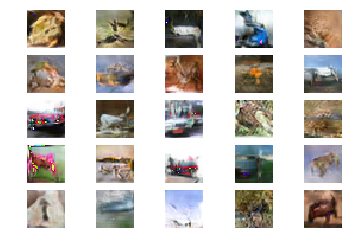

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 154 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.55, acc.: 75.94%] [G loss: 0.90]


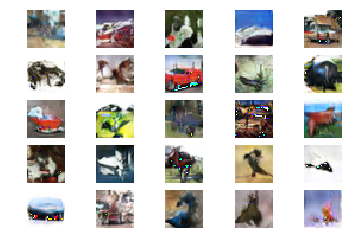

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 155 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.51 sec  - [D loss: 0.61, acc.: 69.06%] [G loss: 0.93]


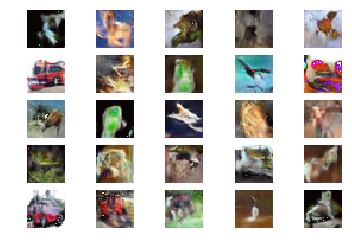

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 156 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.69, acc.: 49.90%] [G loss: 0.83]


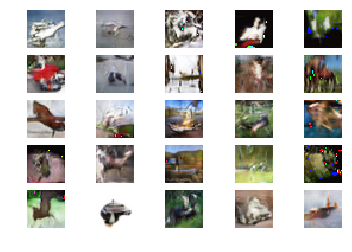

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 157 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.68, acc.: 53.23%] [G loss: 0.96]


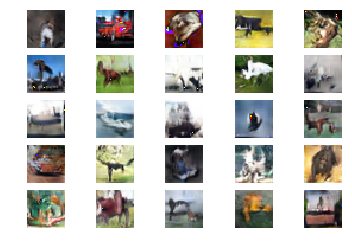

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 158 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.62, acc.: 67.92%] [G loss: 0.82]


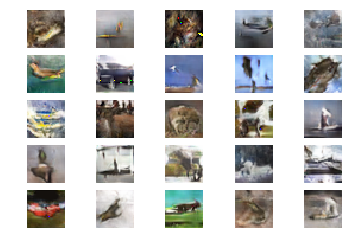

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 159 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.61, acc.: 65.73%] [G loss: 0.90]


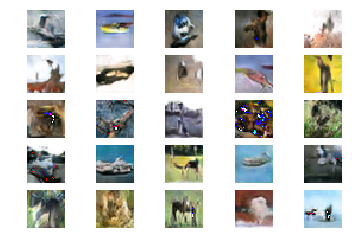

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 160 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.60, acc.: 72.40%] [G loss: 0.84]
Image grid result save.


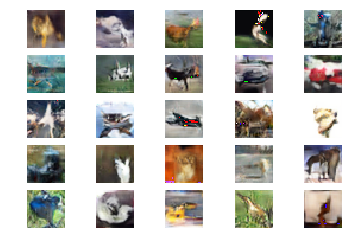

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 161 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.66, acc.: 66.56%] [G loss: 0.81]


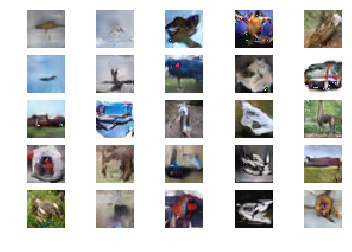

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 162 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.62, acc.: 61.46%] [G loss: 0.92]


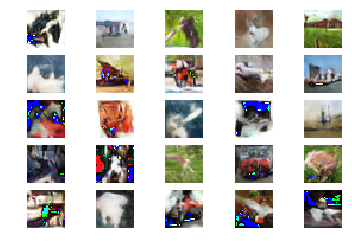

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 163 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.72, acc.: 62.81%] [G loss: 0.96]


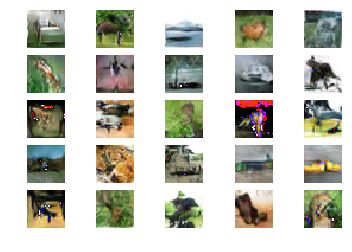

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 164 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.64, acc.: 61.25%] [G loss: 0.86]


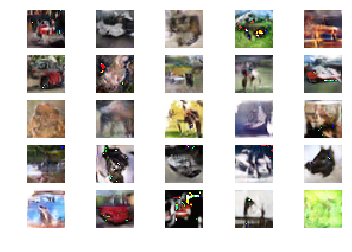

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 165 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.70, acc.: 58.33%] [G loss: 0.77]


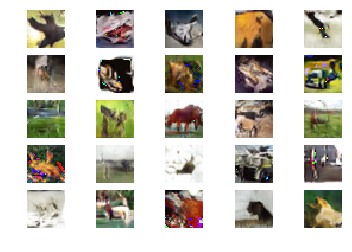

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 166 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.73, acc.: 44.58%] [G loss: 0.89]


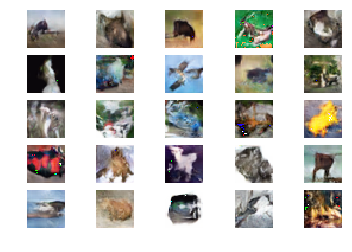

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 167 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.63, acc.: 66.56%] [G loss: 0.85]


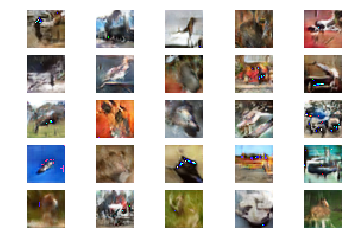

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 168 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.63, acc.: 70.42%] [G loss: 0.74]


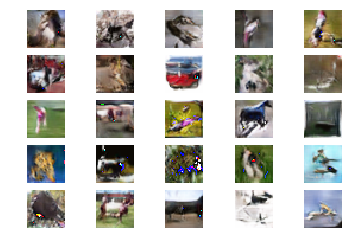

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 169 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.62, acc.: 58.54%] [G loss: 0.93]


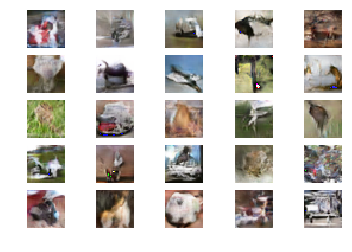

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 170 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.69, acc.: 46.56%] [G loss: 0.85]
Image grid result save.


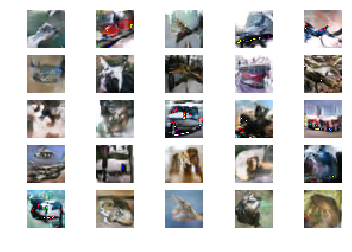

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 171 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.60, acc.: 68.33%] [G loss: 1.03]


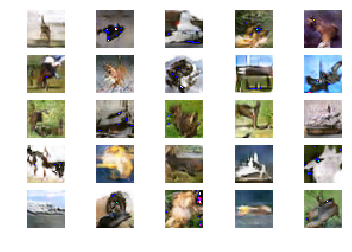

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 172 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.64, acc.: 69.48%] [G loss: 1.02]


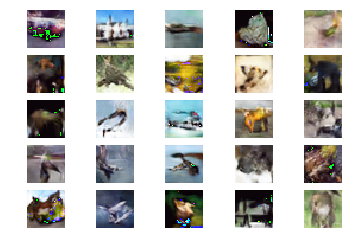

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 173 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.58, acc.: 63.23%] [G loss: 1.01]


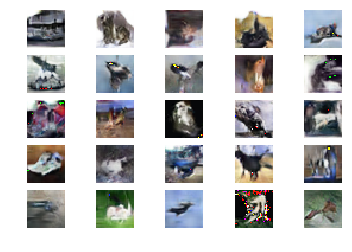

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 174 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.66, acc.: 59.90%] [G loss: 0.58]


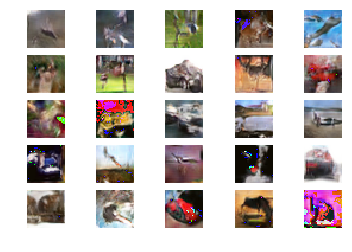

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 175 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.60, acc.: 64.38%] [G loss: 0.90]


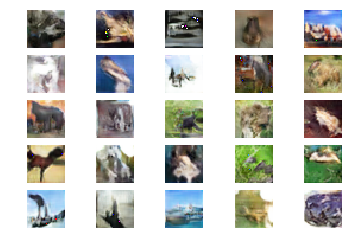

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 176 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.51 sec  - [D loss: 0.47, acc.: 80.62%] [G loss: 0.90]


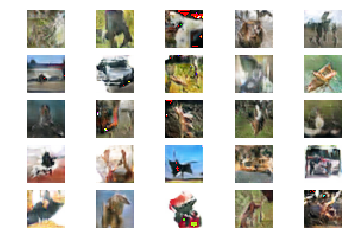

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 177 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.55 sec  - [D loss: 0.59, acc.: 66.15%] [G loss: 1.03]


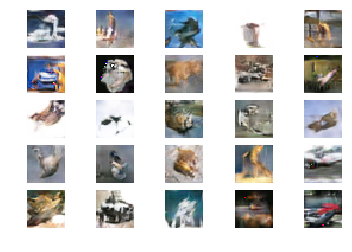

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 178 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.53, acc.: 75.94%] [G loss: 1.19]


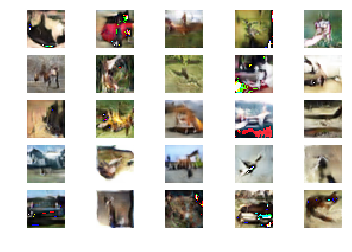

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 179 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.39, acc.: 81.98%] [G loss: 0.99]


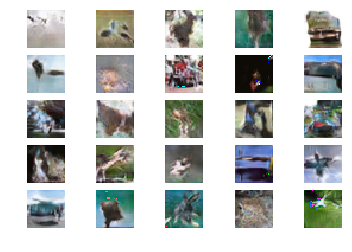

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 180 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.63, acc.: 62.81%] [G loss: 0.77]
Image grid result save.


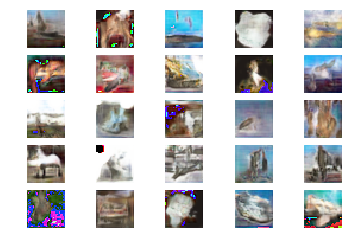

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 181 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.62, acc.: 67.71%] [G loss: 1.20]


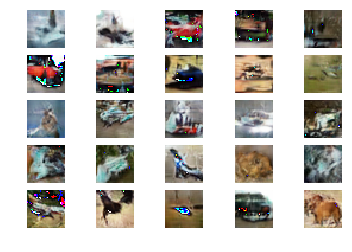

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 182 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.43, acc.: 79.27%] [G loss: 0.79]


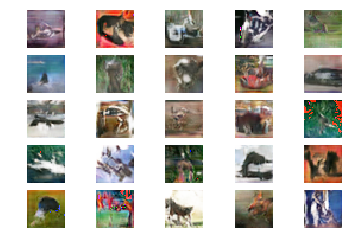

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 183 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.47, acc.: 77.71%] [G loss: 0.69]


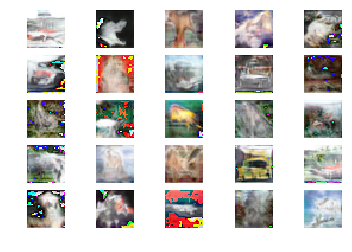

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 184 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.13, acc.: 96.67%] [G loss: 1.29]


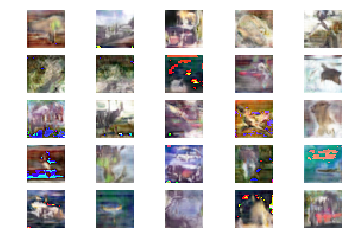

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 185 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.45, acc.: 79.27%] [G loss: 0.69]


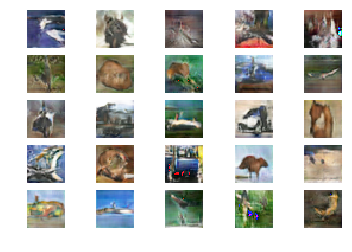

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 186 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.61, acc.: 64.38%] [G loss: 0.19]


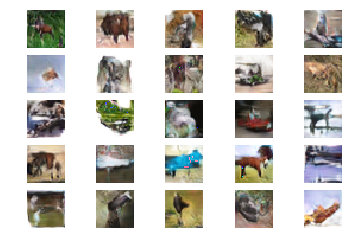

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 187 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.22, acc.: 98.44%] [G loss: 0.29]


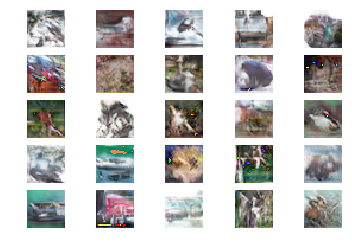

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 188 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.57, acc.: 73.44%] [G loss: 1.55]


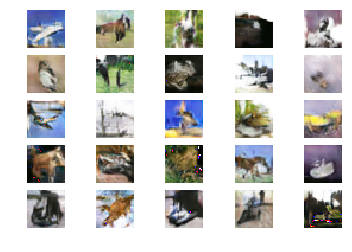

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 189 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.56, acc.: 68.33%] [G loss: 0.23]


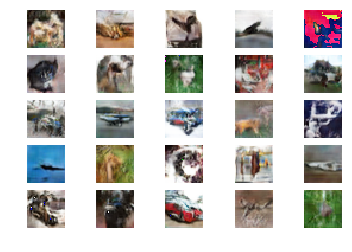

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 190 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.58, acc.: 68.33%] [G loss: 1.04]
Image grid result save.


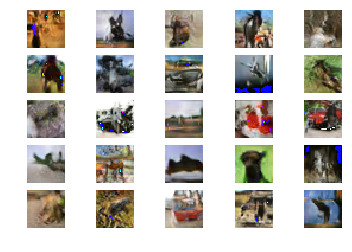

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 191 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.30, acc.: 95.31%] [G loss: 1.27]


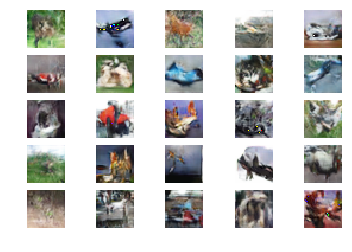

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 192 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.43, acc.: 82.40%] [G loss: 0.92]


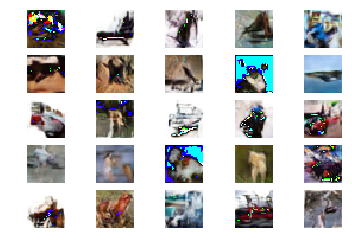

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 193 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.27, acc.: 90.21%] [G loss: 0.09]


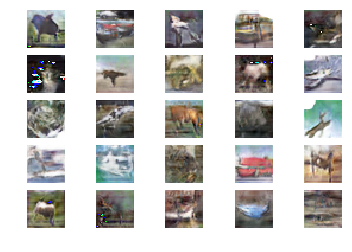

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 194 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.61, acc.: 71.25%] [G loss: 0.66]


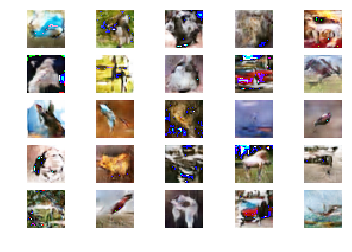

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 195 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.46, acc.: 84.17%] [G loss: 0.13]


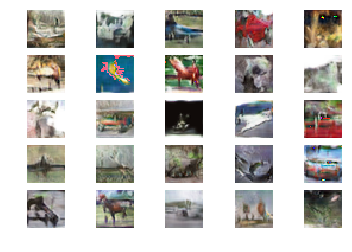

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 196 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.49, acc.: 69.27%] [G loss: 0.11]


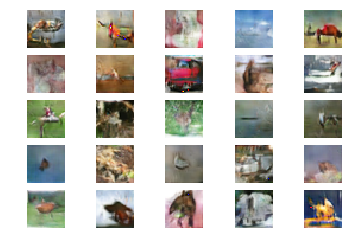

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 197 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.24 sec  - [D loss: 0.34, acc.: 81.77%] [G loss: 0.13]


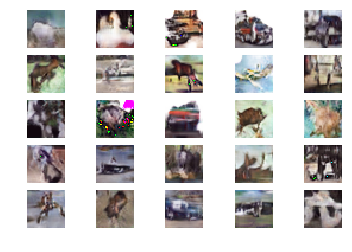

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 198 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.21 sec  - [D loss: 0.30, acc.: 93.33%] [G loss: 1.25]


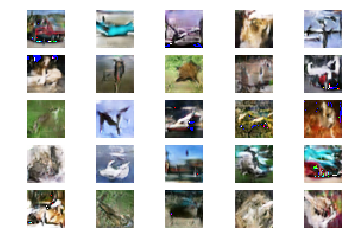

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 199 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.55, acc.: 77.71%] [G loss: 1.51]


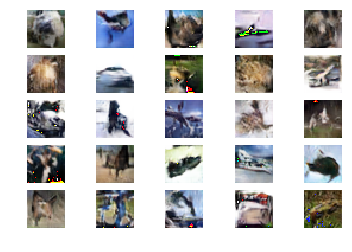

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 200 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.60, acc.: 72.81%] [G loss: 0.16]
Image grid result save.


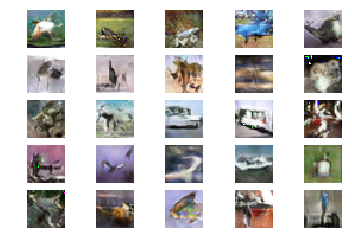

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 201 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.36, acc.: 89.06%] [G loss: 0.23]


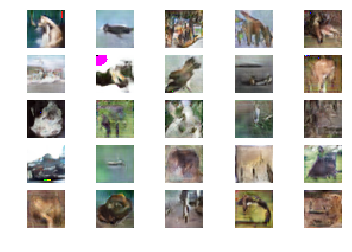

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 202 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.69, acc.: 65.00%] [G loss: 1.32]


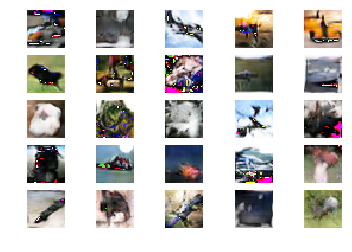

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 203 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.44, acc.: 79.27%] [G loss: 0.09]


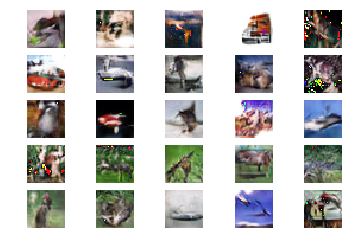

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 204 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.49, acc.: 71.46%] [G loss: 0.06]


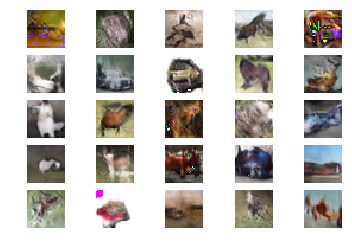

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 205 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.55 sec  - [D loss: 0.26, acc.: 86.67%] [G loss: 1.11]


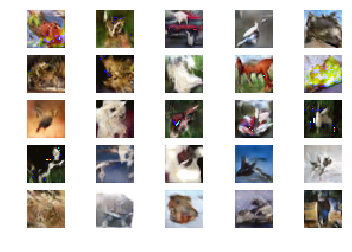

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 206 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.50, acc.: 72.81%] [G loss: 0.13]


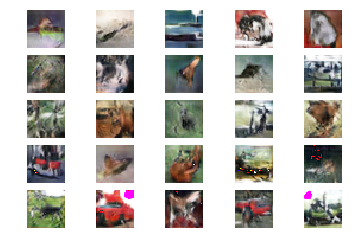

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 207 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.40, acc.: 89.06%] [G loss: 0.08]


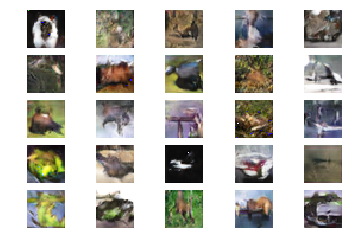

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 208 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.29, acc.: 83.33%] [G loss: 1.12]


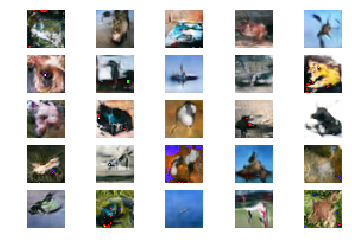

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 209 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.57, acc.: 67.50%] [G loss: 0.04]


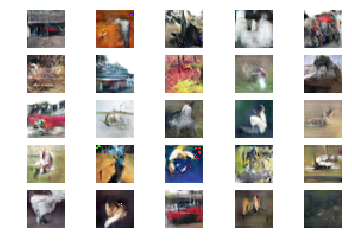

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 210 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.48, acc.: 76.35%] [G loss: 0.05]
Image grid result save.


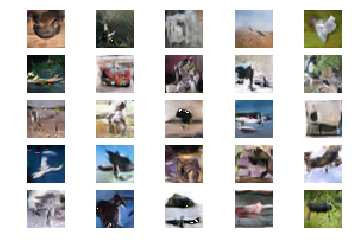

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 211 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.23 sec  - [D loss: 0.54, acc.: 73.02%] [G loss: 0.03]


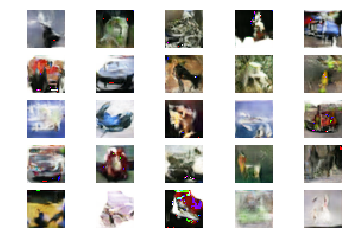

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 212 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.19 sec  - [D loss: 0.51, acc.: 74.79%] [G loss: 0.05]


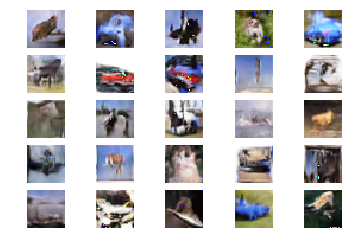

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 213 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.21 sec  - [D loss: 0.50, acc.: 69.69%] [G loss: 0.06]


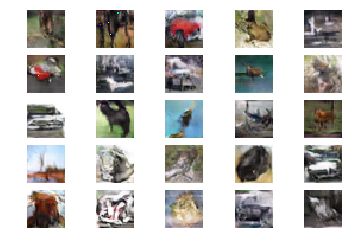

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 214 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.41, acc.: 81.04%] [G loss: 0.03]


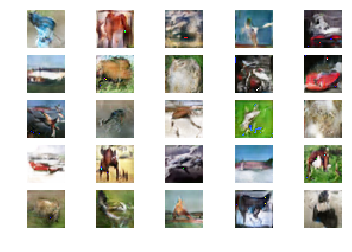

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 215 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.77, acc.: 53.23%] [G loss: 0.05]


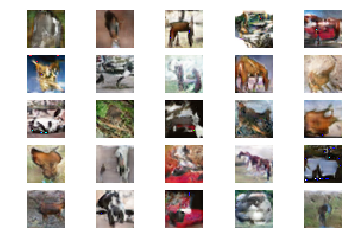

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 216 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.68, acc.: 57.92%] [G loss: 1.28]


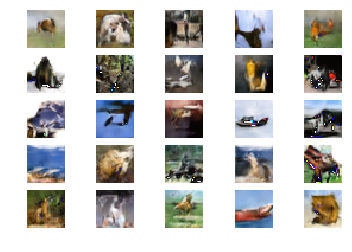

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 217 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.51, acc.: 80.42%] [G loss: 0.03]


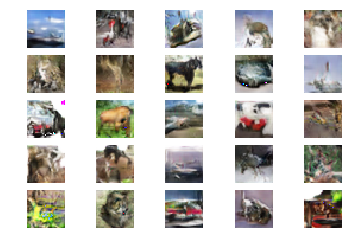

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 218 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.43, acc.: 84.17%] [G loss: 0.05]


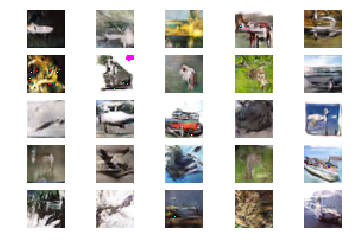

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 219 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.29, acc.: 88.44%] [G loss: 0.97]


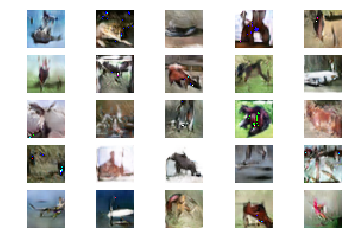

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 220 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.62, acc.: 69.48%] [G loss: 0.03]
Image grid result save.


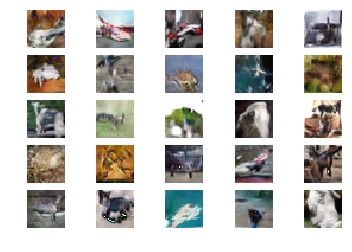

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 221 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.63, acc.: 69.90%] [G loss: 0.05]


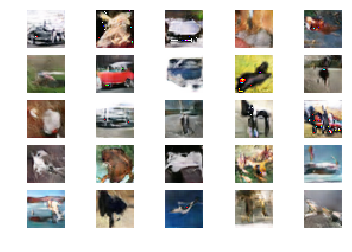

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 222 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.45, acc.: 77.92%] [G loss: 0.08]


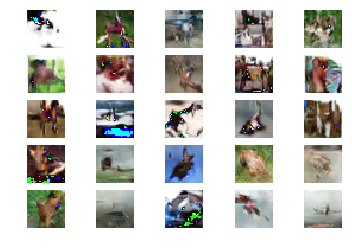

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 223 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.49, acc.: 77.92%] [G loss: 0.20]


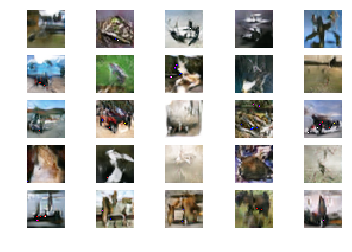

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 224 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.58, acc.: 67.92%] [G loss: 1.26]


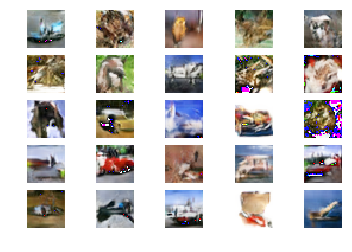

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 225 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.51 sec  - [D loss: 0.59, acc.: 71.46%] [G loss: 1.09]


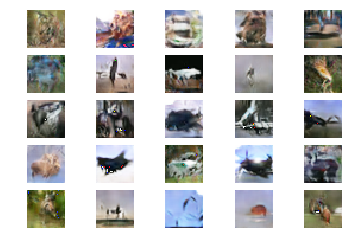

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 226 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.34, acc.: 83.33%] [G loss: 0.03]


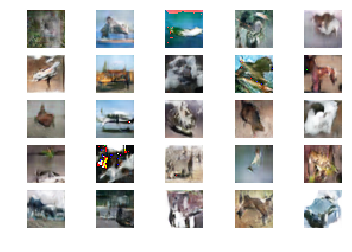

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 227 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.38, acc.: 83.75%] [G loss: 1.03]


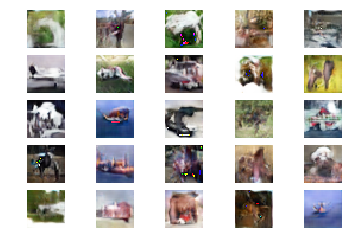

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 228 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.78, acc.: 50.73%] [G loss: 0.03]


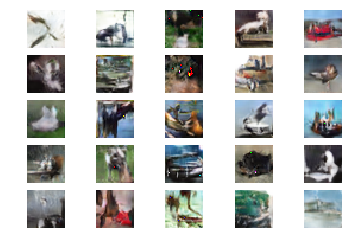

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 229 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.86, acc.: 45.42%] [G loss: 0.04]


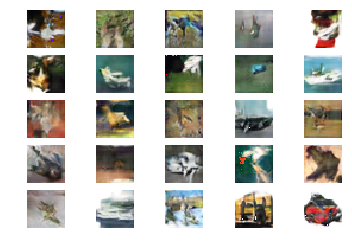

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 230 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.53, acc.: 82.40%] [G loss: 0.04]
Image grid result save.


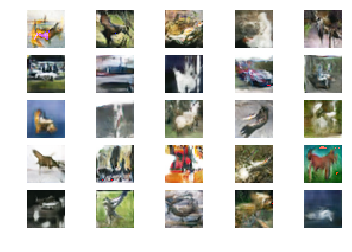

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 231 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.43, acc.: 84.17%] [G loss: 0.01]


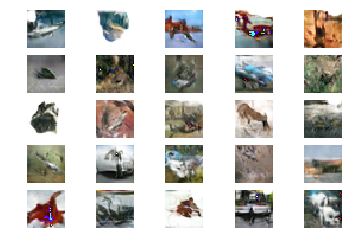

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 232 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.58, acc.: 66.15%] [G loss: 0.23]


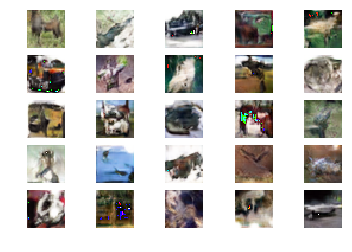

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 233 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.55 sec  - [D loss: 0.35, acc.: 90.62%] [G loss: 0.03]


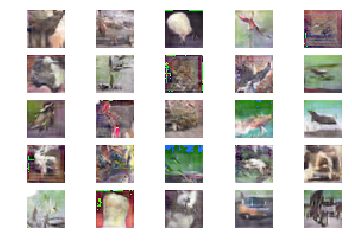

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 234 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.54, acc.: 74.79%] [G loss: 0.05]


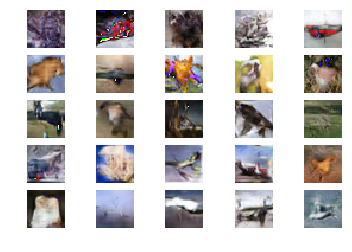

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 235 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.25, acc.: 86.67%] [G loss: 0.73]


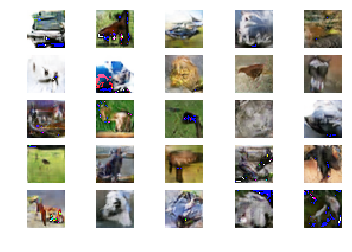

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 236 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.34, acc.: 88.85%] [G loss: 1.09]


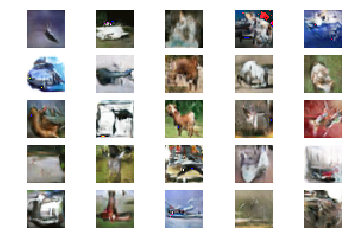

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 237 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.67, acc.: 65.00%] [G loss: 0.03]


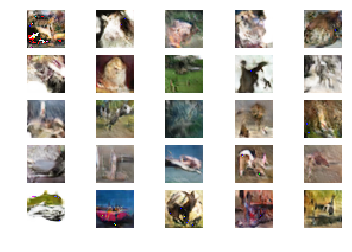

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 238 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.64, acc.: 65.00%] [G loss: 1.80]


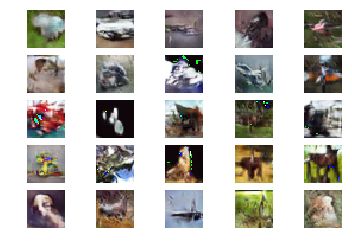

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 239 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.66, acc.: 59.69%] [G loss: 0.89]


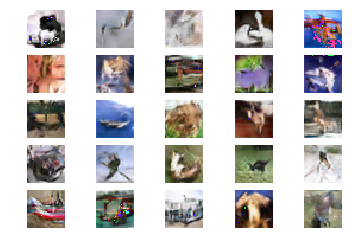

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 240 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.47, acc.: 70.83%] [G loss: 0.01]
Image grid result save.


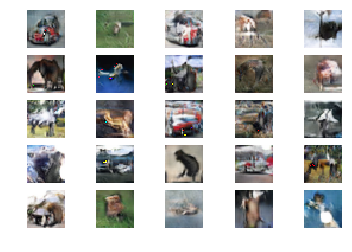

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 241 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.57, acc.: 68.54%] [G loss: 0.03]


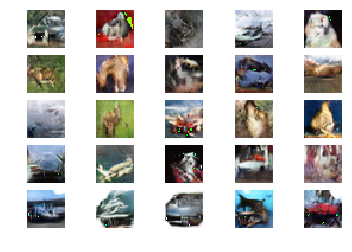

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 242 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.59, acc.: 63.02%] [G loss: 0.01]


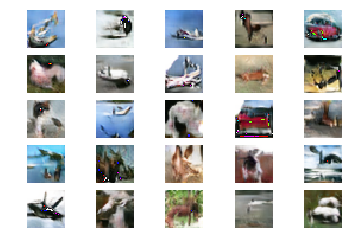

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 243 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.35, acc.: 93.75%] [G loss: 1.33]


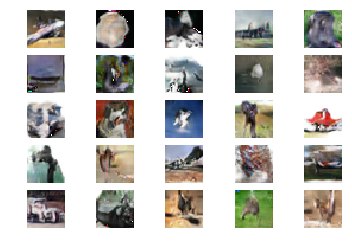

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 244 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.57, acc.: 66.15%] [G loss: 0.03]


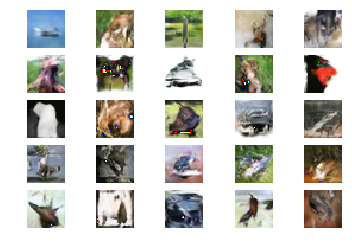

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 245 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.61, acc.: 72.60%] [G loss: 0.01]


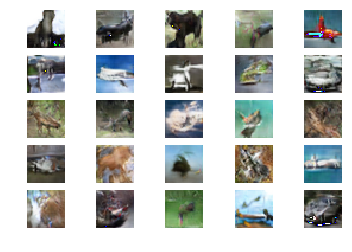

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 246 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.43, acc.: 80.83%] [G loss: 0.01]


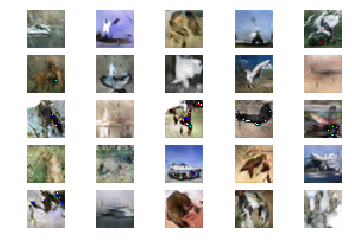

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 247 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.52, acc.: 67.92%] [G loss: 1.35]


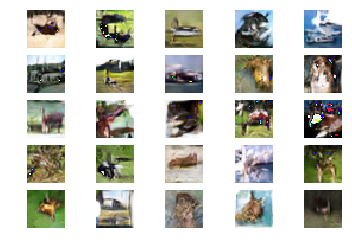

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 248 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.49, acc.: 71.04%] [G loss: 1.06]


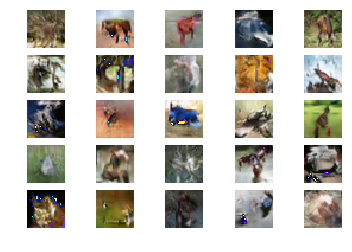

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 249 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.46, acc.: 85.52%] [G loss: 0.01]


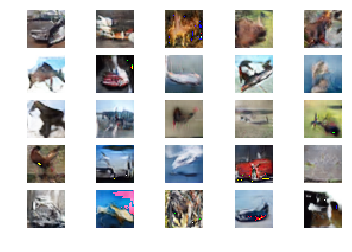

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 250 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.56, acc.: 81.25%] [G loss: 0.00]
Image grid result save.


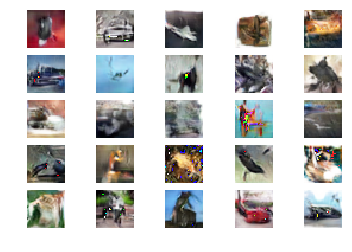

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 251 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.42, acc.: 85.73%] [G loss: 0.01]


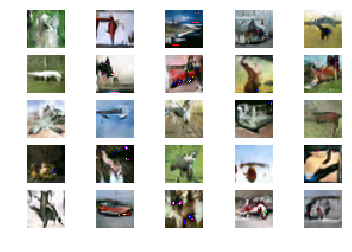

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 252 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.59 sec  - [D loss: 0.64, acc.: 58.13%] [G loss: 1.34]


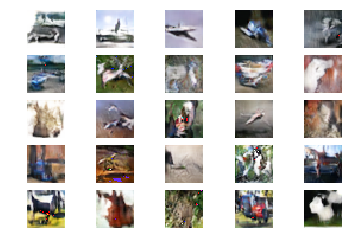

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 253 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.34, acc.: 92.19%] [G loss: 1.27]


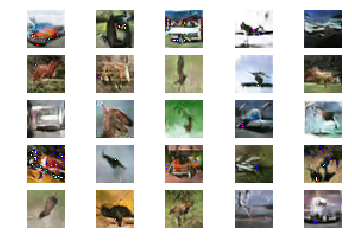

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 254 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.50, acc.: 80.62%] [G loss: 1.04]


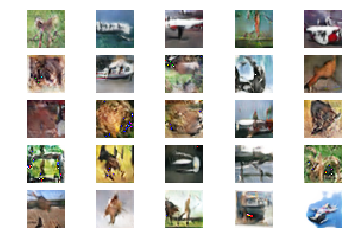

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 255 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.63, acc.: 69.48%] [G loss: 0.01]


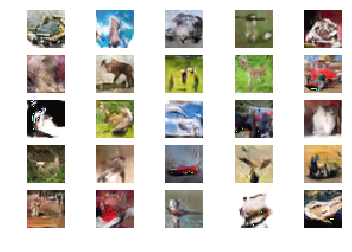

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 256 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.51, acc.: 71.04%] [G loss: 0.01]


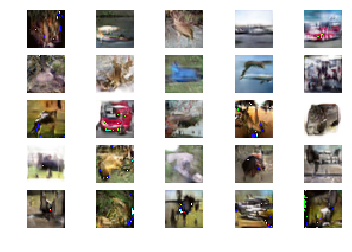

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 257 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.53, acc.: 77.08%] [G loss: 0.01]


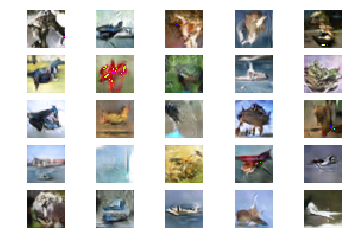

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 258 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.59, acc.: 62.60%] [G loss: 0.01]


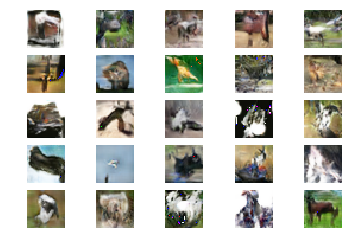

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 259 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.40, acc.: 74.79%] [G loss: 0.02]


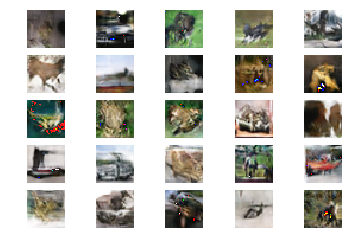

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 260 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.24 sec  - [D loss: 0.59, acc.: 66.56%] [G loss: 0.01]
Image grid result save.


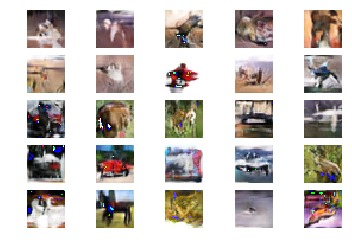

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 261 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.43, acc.: 80.83%] [G loss: 1.23]


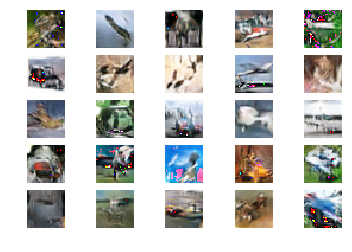

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 262 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.35, acc.: 85.52%] [G loss: 0.01]


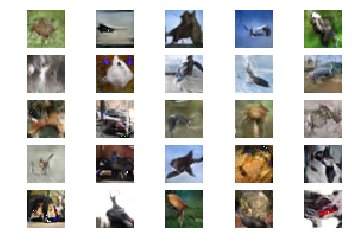

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 263 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.51, acc.: 72.81%] [G loss: 0.00]


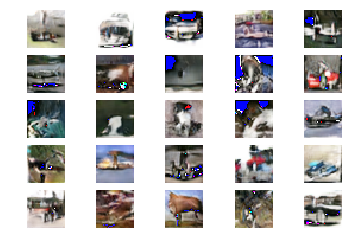

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 264 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.63, acc.: 68.12%] [G loss: 1.27]


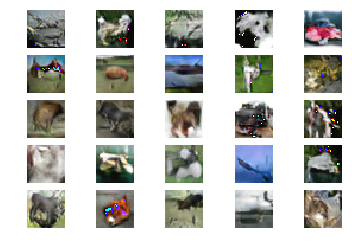

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 265 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.47, acc.: 79.27%] [G loss: 1.69]


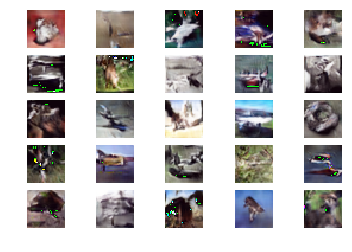

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 266 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.31, acc.: 93.75%] [G loss: 0.01]


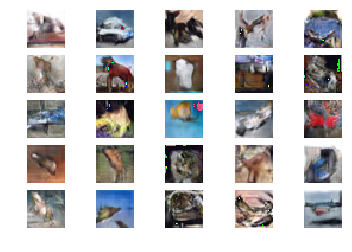

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 267 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.52, acc.: 75.94%] [G loss: 0.01]


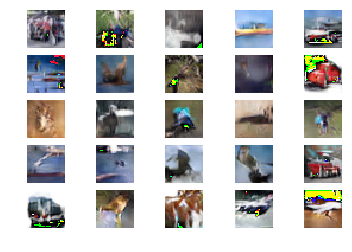

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 268 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.42, acc.: 77.08%] [G loss: 0.01]


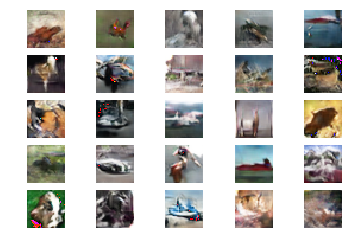

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 269 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.48, acc.: 77.71%] [G loss: 0.01]


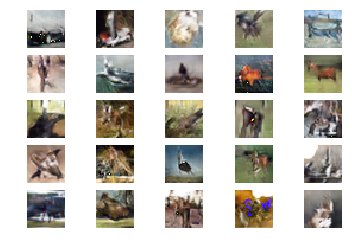

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 270 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.63, acc.: 67.92%] [G loss: 1.44]
Image grid result save.


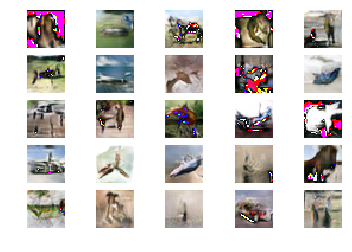

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 271 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.32, acc.: 89.06%] [G loss: 0.00]


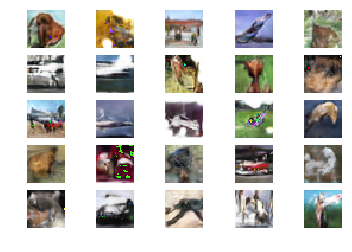

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 272 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.19 sec  - [D loss: 0.50, acc.: 75.94%] [G loss: 0.01]


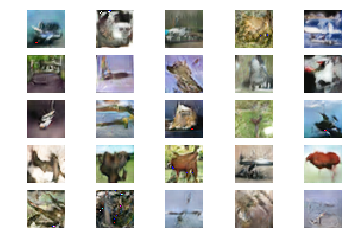

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 273 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.52, acc.: 77.08%] [G loss: 1.28]


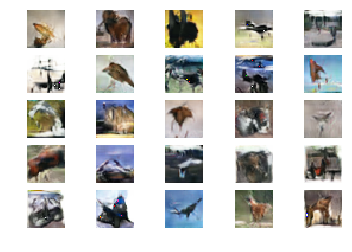

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 274 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.43, acc.: 81.98%] [G loss: 0.01]


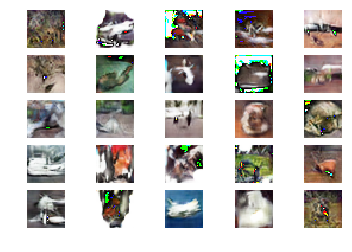

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 275 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.56, acc.: 65.00%] [G loss: 1.26]


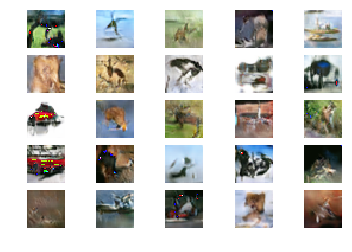

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 276 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.41, acc.: 80.42%] [G loss: 0.00]


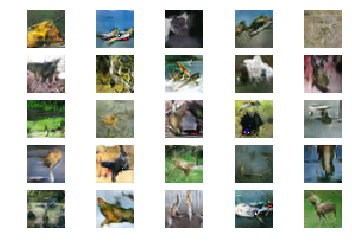

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 277 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.41, acc.: 79.27%] [G loss: 0.01]


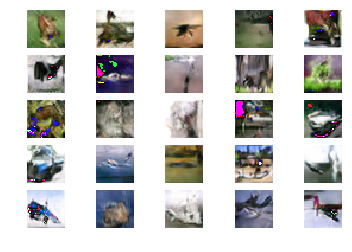

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 278 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.42, acc.: 82.19%] [G loss: 0.02]


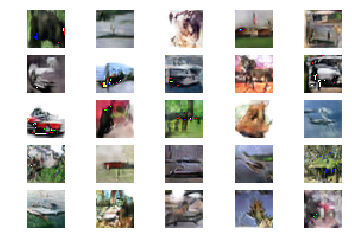

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 279 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.70, acc.: 49.69%] [G loss: 0.00]


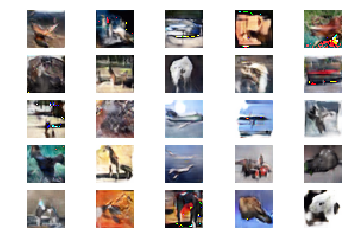

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 280 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.44, acc.: 72.81%] [G loss: 0.02]
Image grid result save.


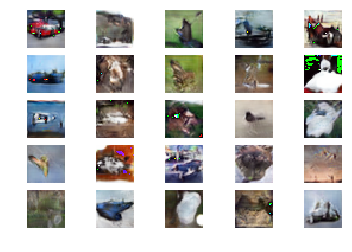

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 281 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.58 sec  - [D loss: 0.43, acc.: 85.94%] [G loss: 1.25]


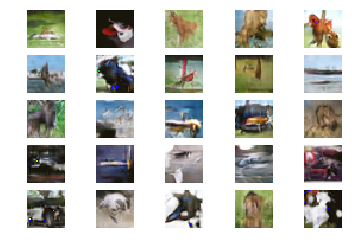

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 282 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.63, acc.: 61.25%] [G loss: 0.00]


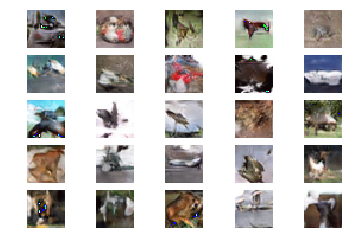

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 283 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.62, acc.: 66.35%] [G loss: 0.01]


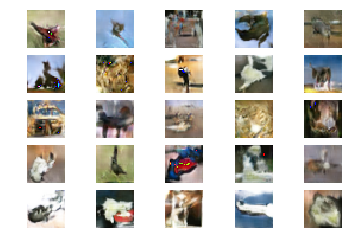

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 284 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.52, acc.: 74.37%] [G loss: 0.01]


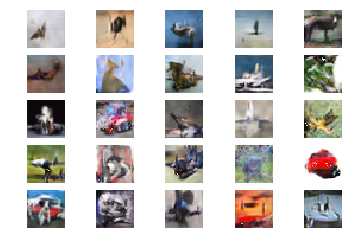

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 285 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.69, acc.: 63.44%] [G loss: 0.01]


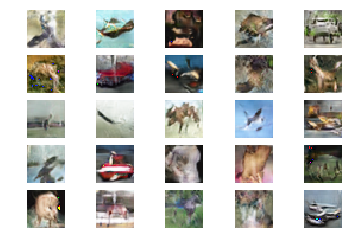

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 286 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.52, acc.: 74.37%] [G loss: 0.08]


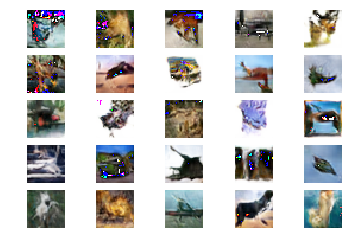

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 287 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.20, acc.: 96.67%] [G loss: 1.04]


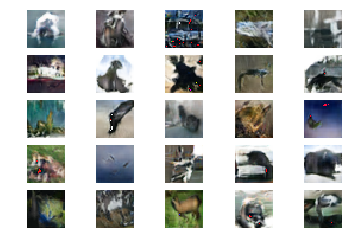

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 288 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.45, acc.: 81.04%] [G loss: 0.01]


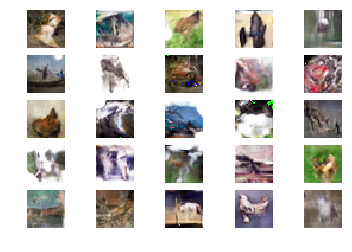

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 289 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.45, acc.: 76.15%] [G loss: 0.01]


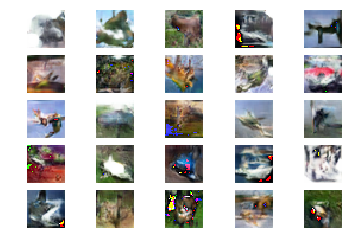

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 290 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.65, acc.: 64.79%] [G loss: 0.01]
Image grid result save.


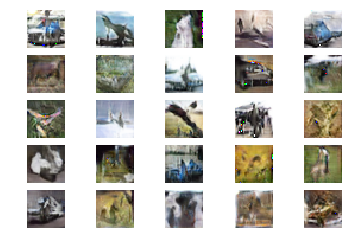

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 291 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.53, acc.: 68.12%] [G loss: 0.01]


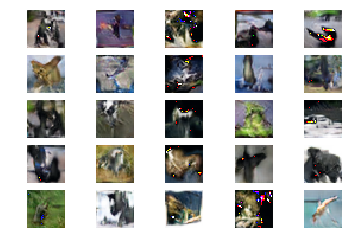

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 292 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.55, acc.: 76.56%] [G loss: 0.06]


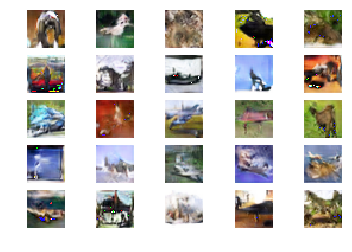

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 293 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.52, acc.: 71.46%] [G loss: 0.02]


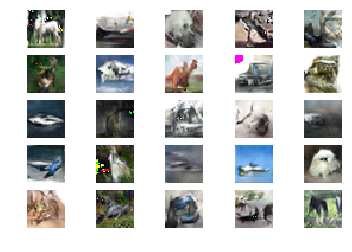

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 294 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.53, acc.: 81.04%] [G loss: 0.91]


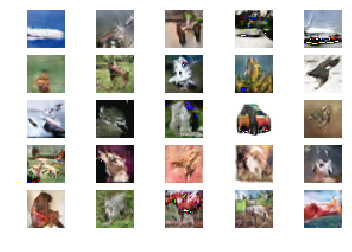

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 295 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.37, acc.: 78.44%] [G loss: 0.01]


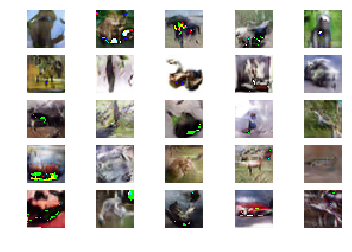

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 296 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.23 sec  - [D loss: 0.47, acc.: 80.83%] [G loss: 0.01]


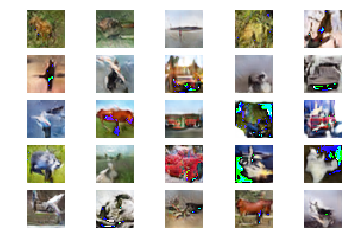

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 297 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.34, acc.: 87.29%] [G loss: 0.01]


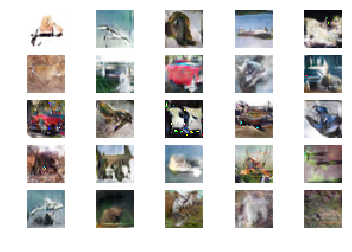

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 298 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.71, acc.: 59.90%] [G loss: 0.00]


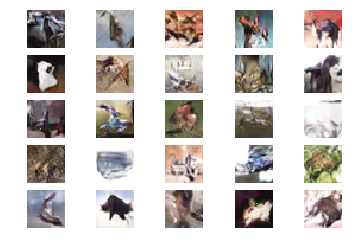

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 299 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.44, acc.: 80.83%] [G loss: 1.86]


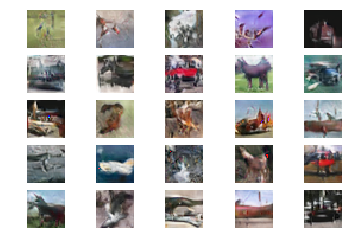

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 300 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.32, acc.: 85.73%] [G loss: 0.01]
Image grid result save.


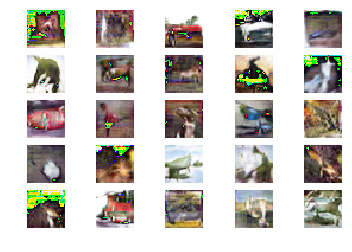

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 301 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.53 sec  - [D loss: 0.32, acc.: 91.98%] [G loss: 0.01]


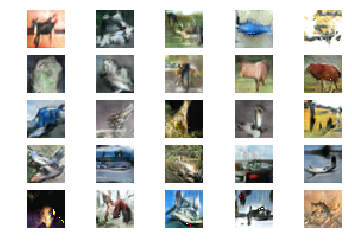

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 302 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.35, acc.: 87.29%] [G loss: 2.11]


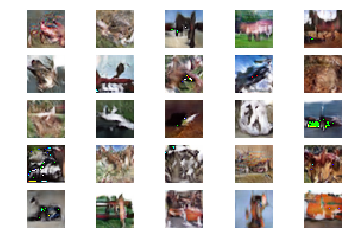

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 303 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.31, acc.: 86.87%] [G loss: 2.01]


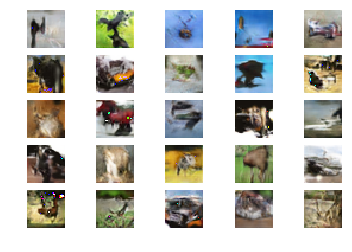

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 304 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.35, acc.: 87.29%] [G loss: 1.33]


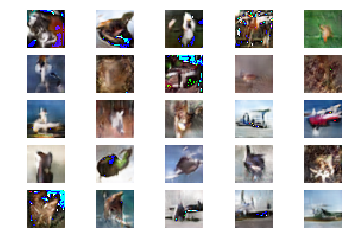

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 305 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.66, acc.: 65.21%] [G loss: 0.01]


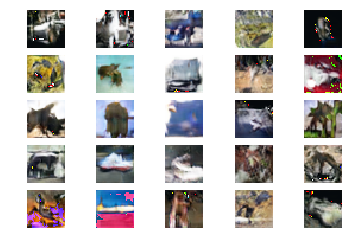

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 306 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.45, acc.: 82.19%] [G loss: 0.00]


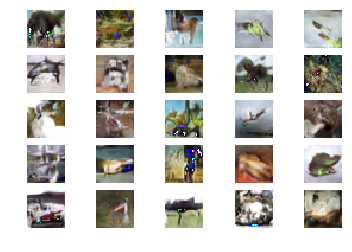

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 307 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.24 sec  - [D loss: 0.63, acc.: 67.29%] [G loss: 0.01]


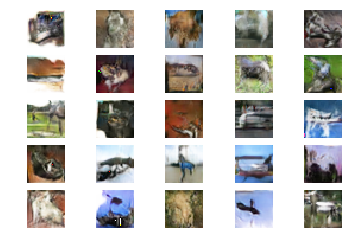

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 308 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.55, acc.: 72.81%] [G loss: 1.56]


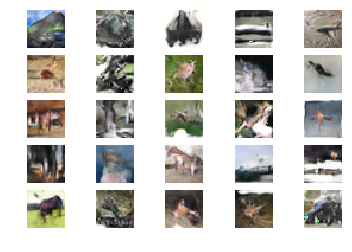

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 309 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.76, acc.: 49.69%] [G loss: 0.92]


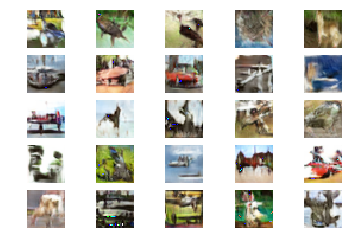

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 310 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.54 sec  - [D loss: 0.64, acc.: 57.71%] [G loss: 1.55]
Image grid result save.


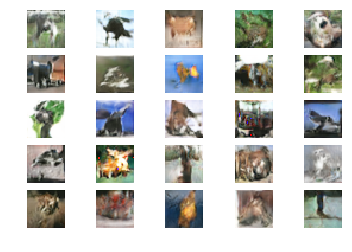

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 311 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.27, acc.: 87.08%] [G loss: 0.01]


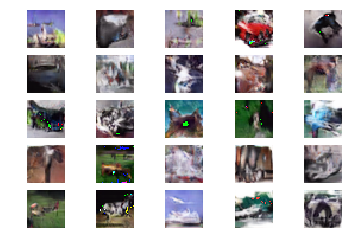

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 312 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.28, acc.: 89.06%] [G loss: 0.07]


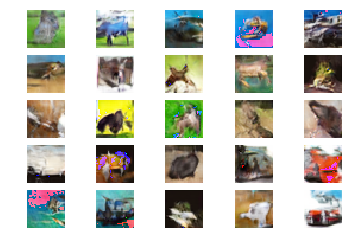

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 313 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.46, acc.: 71.88%] [G loss: 0.01]


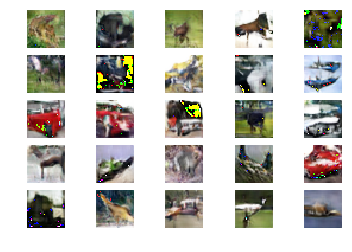

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 314 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.59, acc.: 64.38%] [G loss: 1.48]


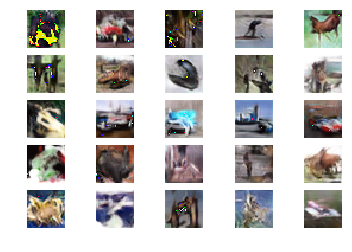

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 315 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.42, acc.: 83.96%] [G loss: 0.01]


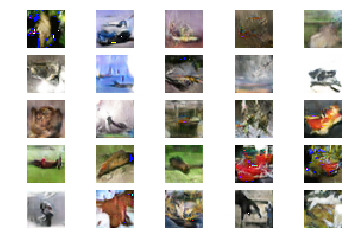

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 316 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.48 sec  - [D loss: 0.27, acc.: 88.44%] [G loss: 0.01]


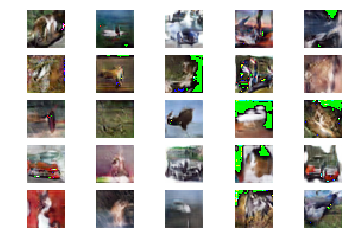

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 317 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.52 sec  - [D loss: 0.52, acc.: 73.23%] [G loss: 1.39]


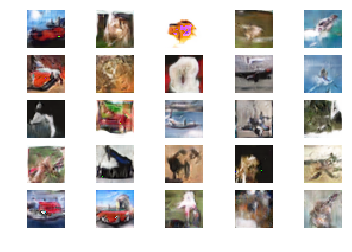

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 318 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.64, acc.: 68.12%] [G loss: 0.00]


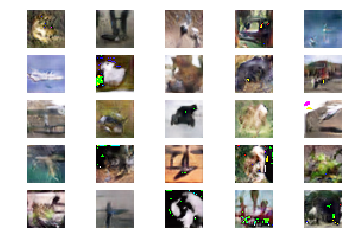

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 319 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.67, acc.: 65.94%] [G loss: 1.62]


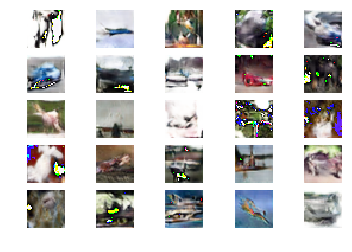

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 320 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.31, acc.: 88.85%] [G loss: 0.00]
Image grid result save.


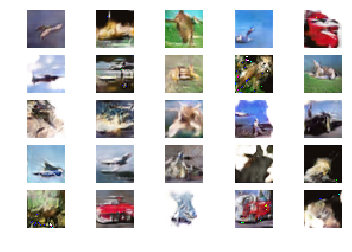

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 321 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.66, acc.: 64.38%] [G loss: 1.73]


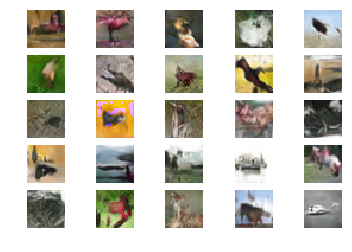

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 322 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.23, acc.: 95.10%] [G loss: 0.00]


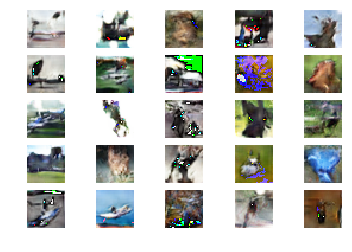

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 323 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.26, acc.: 95.10%] [G loss: 0.68]


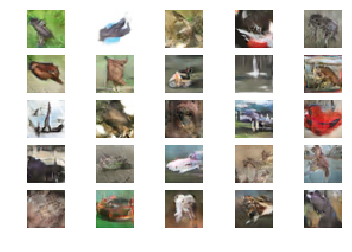

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 324 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.35, acc.: 85.73%] [G loss: 0.01]


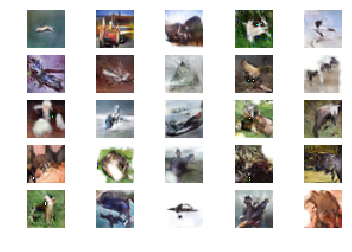

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 325 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.04, acc.: 100.00%] [G loss: 1.73]


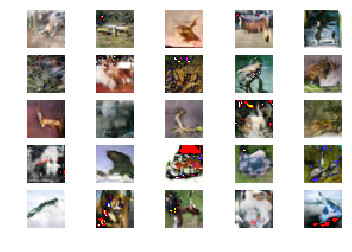

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 326 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.36, acc.: 85.52%] [G loss: 0.01]


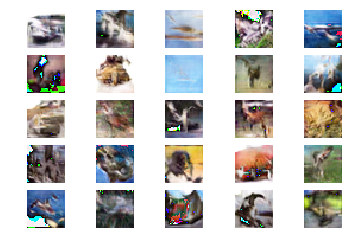

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 327 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.48, acc.: 74.58%] [G loss: 1.92]


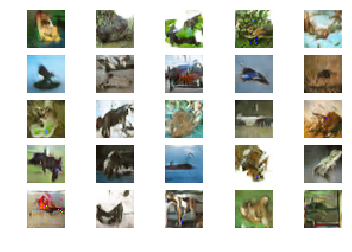

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 328 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.40, acc.: 87.29%] [G loss: 0.00]


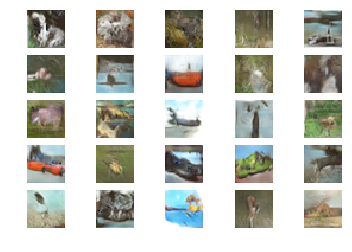

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 329 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.43, acc.: 81.25%] [G loss: 0.07]


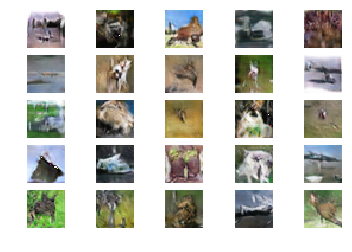

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 330 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.61, acc.: 66.15%] [G loss: 0.01]
Image grid result save.


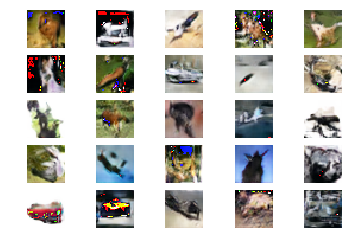

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 331 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.60, acc.: 74.17%] [G loss: 2.06]


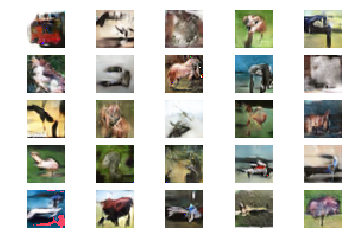

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 332 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.68, acc.: 67.92%] [G loss: 1.79]


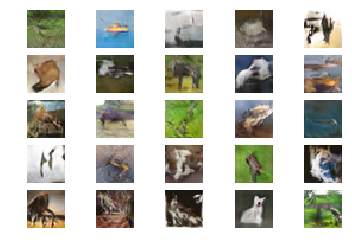

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 333 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.54, acc.: 72.60%] [G loss: 0.01]


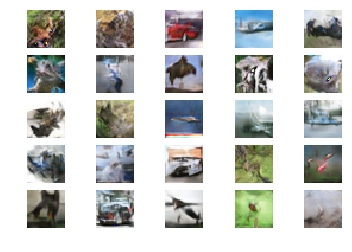

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 334 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.35, acc.: 93.75%] [G loss: 0.00]


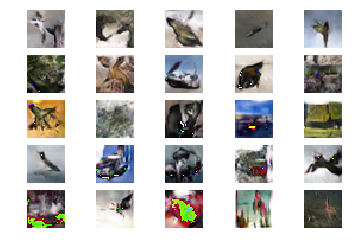

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 335 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.51, acc.: 77.08%] [G loss: 1.20]


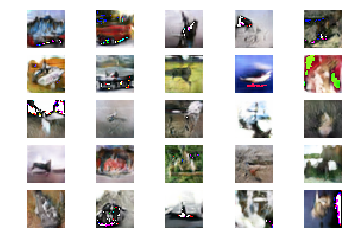

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 336 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.46, acc.: 77.29%] [G loss: 1.00]


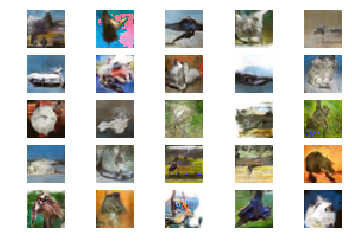

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 337 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.22 sec  - [D loss: 0.51, acc.: 77.50%] [G loss: 1.11]


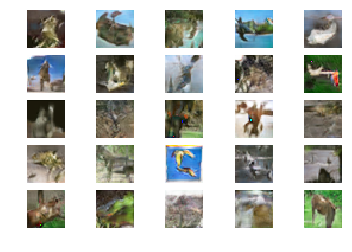

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 338 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.37, acc.: 89.06%] [G loss: 0.11]


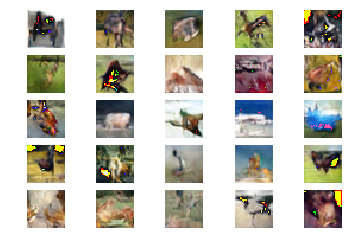

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 339 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.36, acc.: 91.98%] [G loss: 0.00]


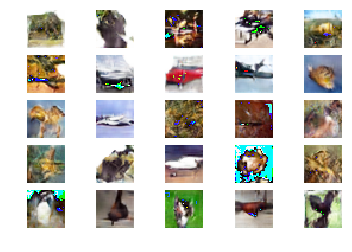

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 340 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.63, acc.: 63.65%] [G loss: 0.07]
Image grid result save.


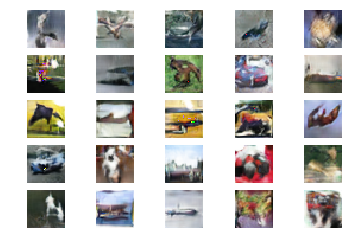

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 341 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.38, acc.: 88.65%] [G loss: 0.00]


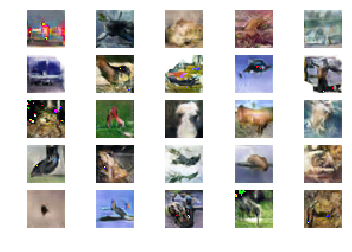

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 342 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.53, acc.: 75.73%] [G loss: 1.36]


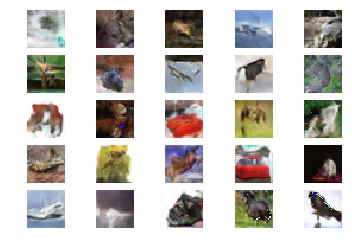

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 343 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.36, acc.: 85.52%] [G loss: 1.50]


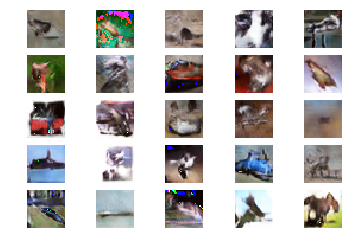

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 344 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.37, acc.: 85.73%] [G loss: 1.23]


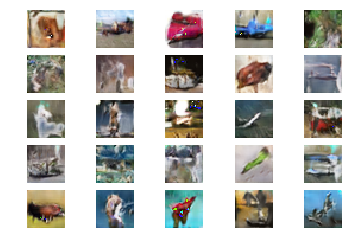

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 345 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.32, acc.: 93.75%] [G loss: 0.10]


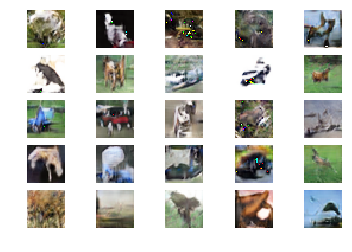

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 346 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.62, acc.: 63.96%] [G loss: 0.00]


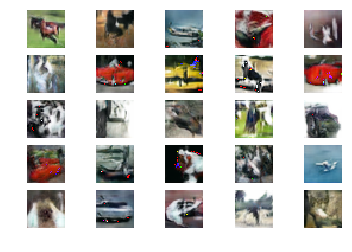

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 347 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.58, acc.: 65.31%] [G loss: 1.29]


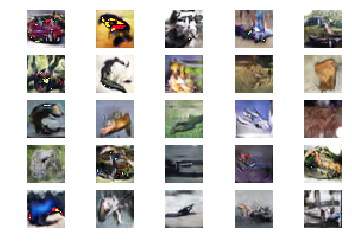

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 348 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.58, acc.: 69.27%] [G loss: 0.00]


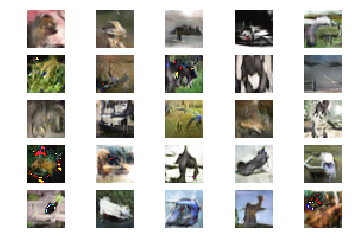

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 349 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.45, acc.: 78.12%] [G loss: 0.01]


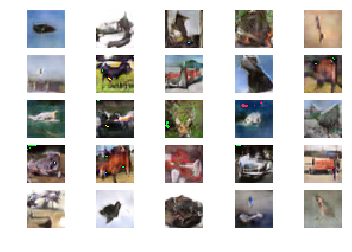

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 350 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.38, acc.: 87.50%] [G loss: 0.00]
Image grid result save.


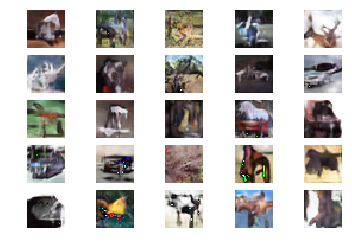

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 351 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.36, acc.: 90.42%] [G loss: 2.51]


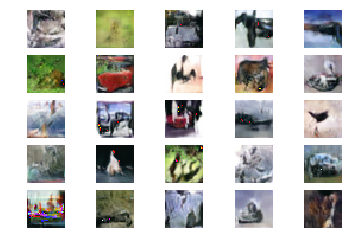

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 352 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.59, acc.: 67.19%] [G loss: 0.01]


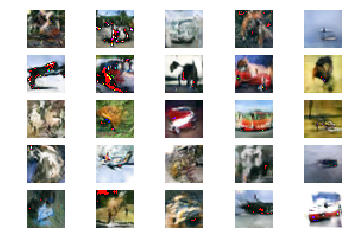

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 353 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.49 sec  - [D loss: 0.70, acc.: 60.31%] [G loss: 0.04]


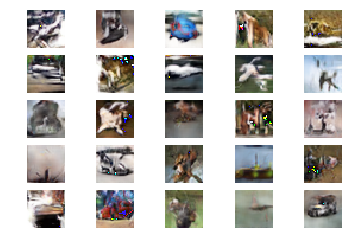

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 354 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.53, acc.: 69.27%] [G loss: 2.41]


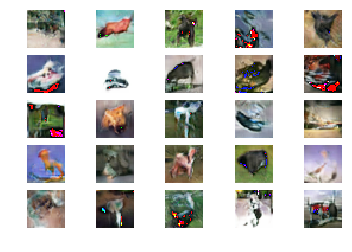

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 355 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.35, acc.: 85.52%] [G loss: 1.37]


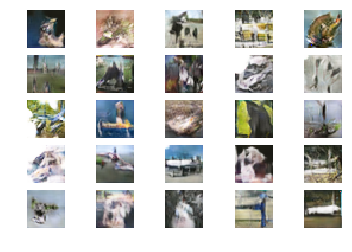

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 356 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.45, acc.: 74.58%] [G loss: 0.81]


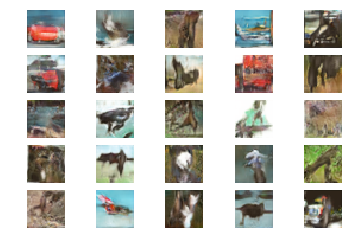

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 357 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.30, acc.: 85.73%] [G loss: 0.00]


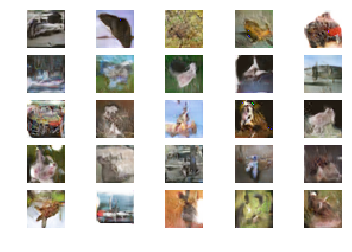

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 358 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.37, acc.: 85.73%] [G loss: 2.09]


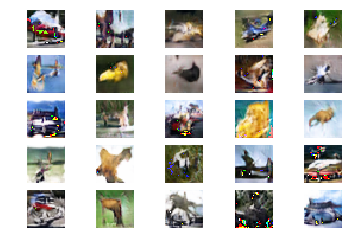

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 359 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.17 sec  - [D loss: 0.23, acc.: 89.06%] [G loss: 0.00]


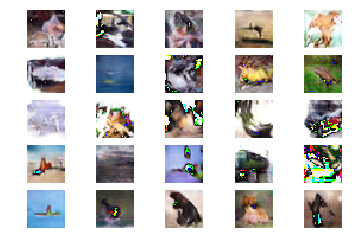

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 360 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.23 sec  - [D loss: 0.26, acc.: 90.42%] [G loss: 0.00]
Image grid result save.


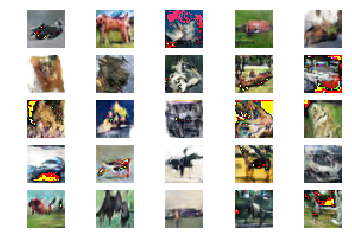

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 361 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.60, acc.: 70.31%] [G loss: 2.14]


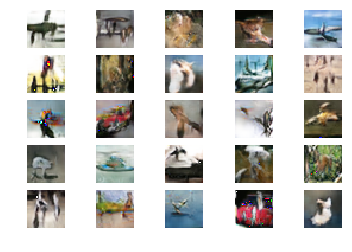

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 362 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.44 sec  - [D loss: 0.49, acc.: 80.62%] [G loss: 0.01]


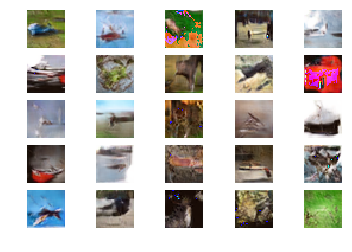

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 363 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.23, acc.: 93.75%] [G loss: 0.00]


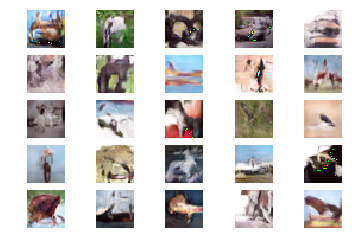

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 364 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.49, acc.: 73.02%] [G loss: 0.00]


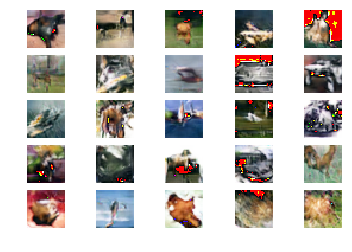

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 365 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.56, acc.: 69.69%] [G loss: 0.02]


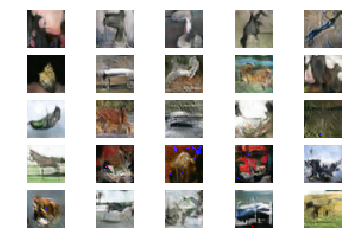

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 366 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.28, acc.: 95.31%] [G loss: 1.88]


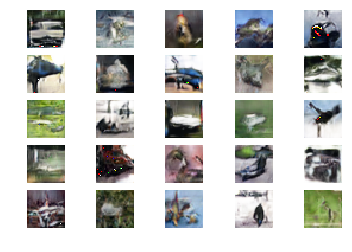

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 367 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.37, acc.: 79.27%] [G loss: 0.00]


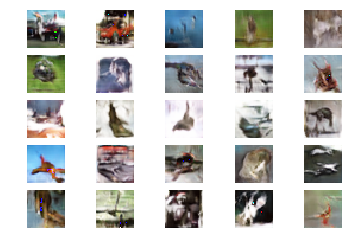

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 368 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.64, acc.: 63.85%] [G loss: 0.00]


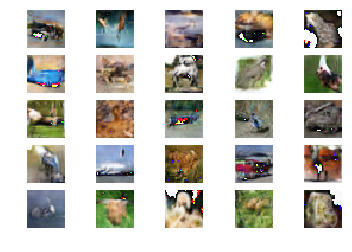

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 369 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.2 sec  - [D loss: 0.35, acc.: 85.94%] [G loss: 0.02]


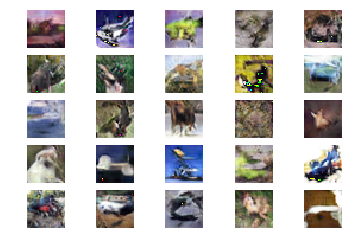

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 370 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.24, acc.: 91.98%] [G loss: 0.01]
Image grid result save.


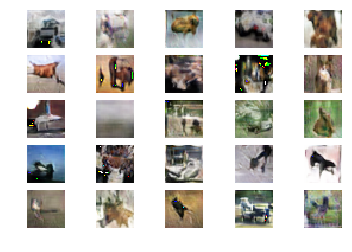

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 371 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.38, acc.: 77.29%] [G loss: 0.00]


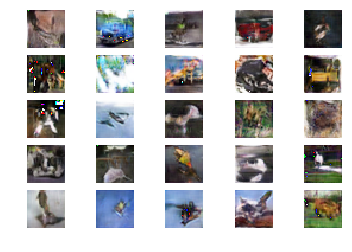

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 372 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.24, acc.: 96.88%] [G loss: 0.00]


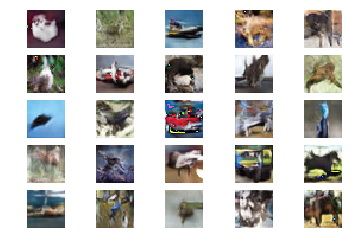

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 373 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.80, acc.: 55.00%] [G loss: 1.18]


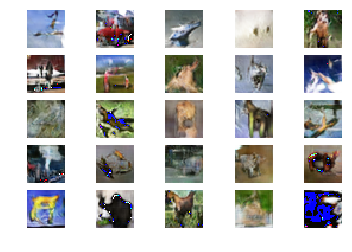

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 374 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.43, acc.: 68.65%] [G loss: 0.00]


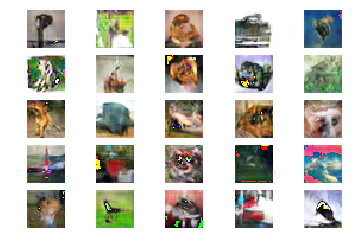

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 375 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.61, acc.: 71.04%] [G loss: 1.40]


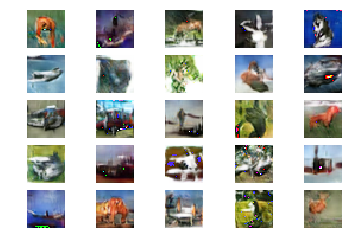

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 376 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.29, acc.: 93.33%] [G loss: 1.15]


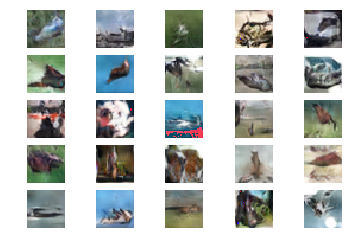

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 377 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.45, acc.: 77.08%] [G loss: 0.00]


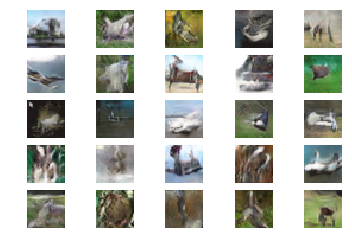

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 378 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.39, acc.: 82.19%] [G loss: 0.01]


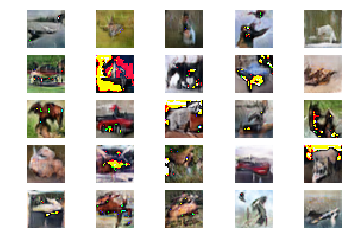

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 379 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.31, acc.: 85.10%] [G loss: 0.76]


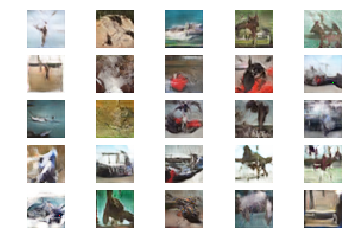

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 380 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.5 sec  - [D loss: 0.66, acc.: 54.58%] [G loss: 0.02]
Image grid result save.


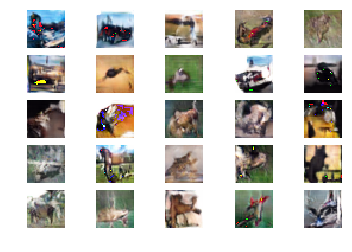

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 381 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.38, acc.: 87.29%] [G loss: 0.01]


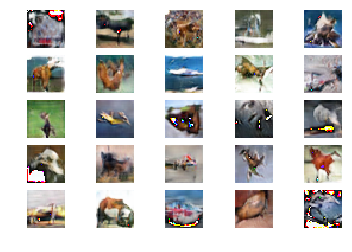

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 382 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.88, acc.: 59.48%] [G loss: 0.01]


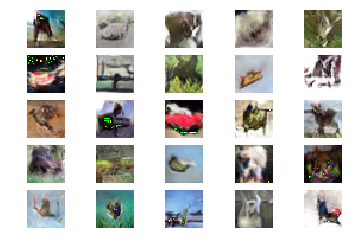

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 383 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.72, acc.: 64.06%] [G loss: 0.00]


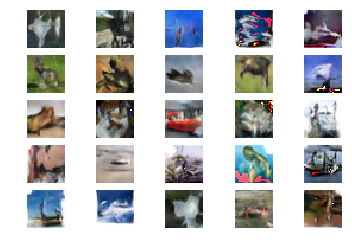

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 384 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.58 sec  - [D loss: 1.07, acc.: 50.63%] [G loss: 0.02]


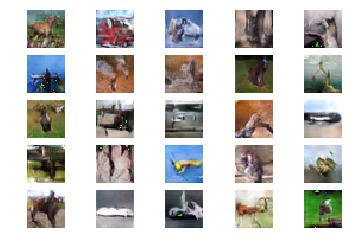

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 385 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.62 sec  - [D loss: 0.51, acc.: 80.62%] [G loss: 0.00]


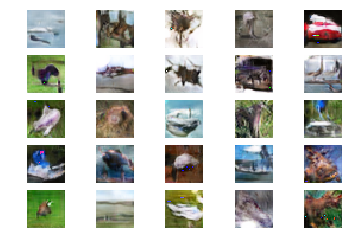

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 386 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.58, acc.: 73.96%] [G loss: 0.04]


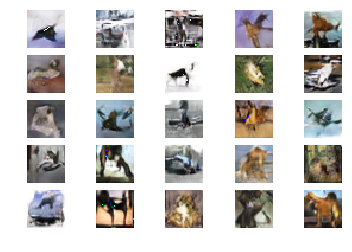

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 387 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.33, acc.: 91.98%] [G loss: 0.00]


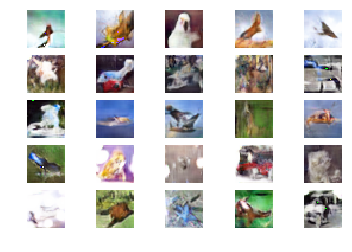

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 388 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.43, acc.: 76.15%] [G loss: 0.00]


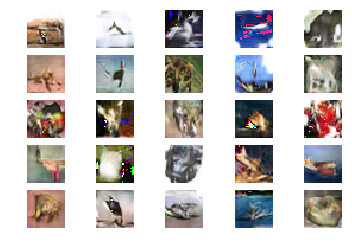

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 389 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.36, acc.: 85.31%] [G loss: 0.00]


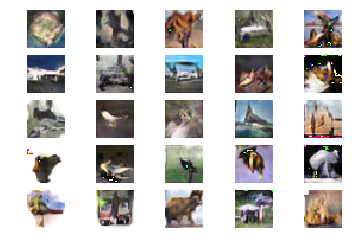

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 390 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.13, acc.: 96.67%] [G loss: 0.02]
Image grid result save.


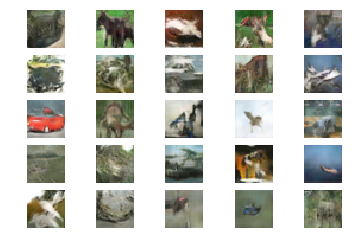

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 391 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 1.05, acc.: 50.52%] [G loss: 0.02]


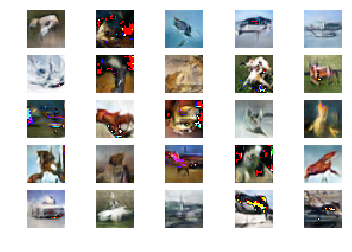

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 392 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.45, acc.: 78.65%] [G loss: 1.81]


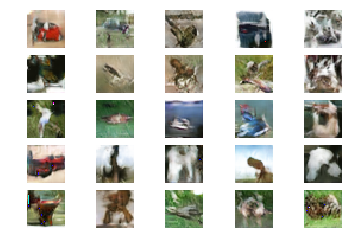

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 393 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.25, acc.: 88.85%] [G loss: 0.00]


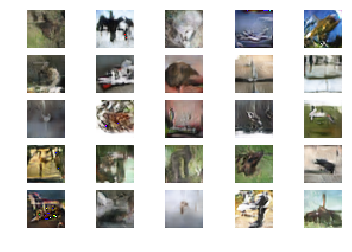

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 394 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.35, acc.: 80.00%] [G loss: 0.01]


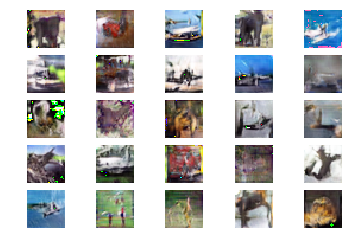

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 395 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.47, acc.: 75.94%] [G loss: 1.64]


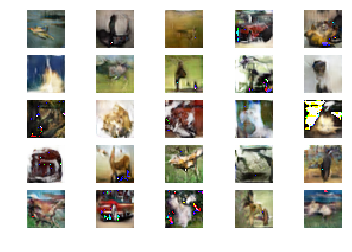

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 396 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.07, acc.: 100.00%] [G loss: 0.02]


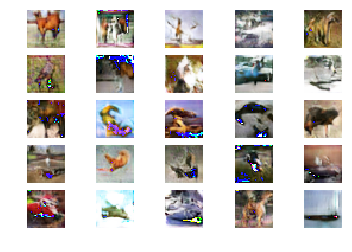

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 397 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.76, acc.: 51.67%] [G loss: 0.03]


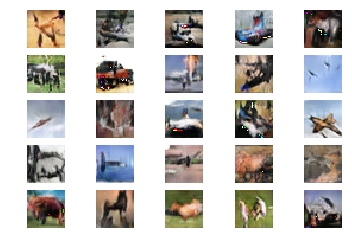

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 398 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.22 sec  - [D loss: 0.31, acc.: 93.33%] [G loss: 0.01]


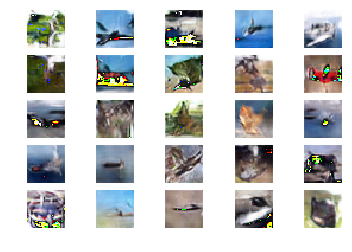

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 399 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.33, acc.: 88.85%] [G loss: 0.00]


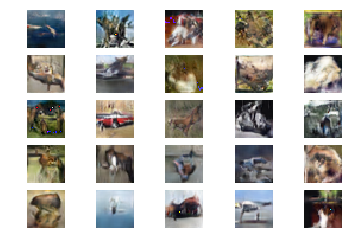

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 400 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.26, acc.: 91.98%] [G loss: 0.02]
Image grid result save.


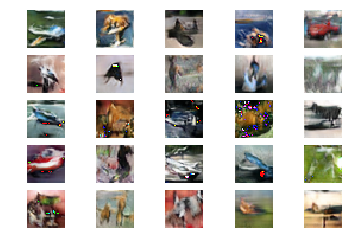

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 401 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.61, acc.: 67.71%] [G loss: 0.03]


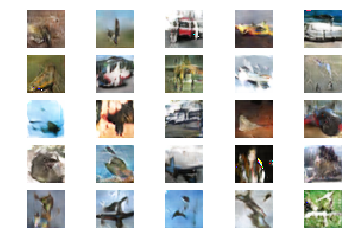

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 402 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.31, acc.: 90.00%] [G loss: 1.73]


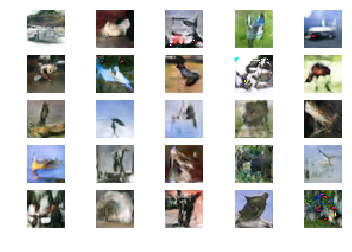

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 403 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.38, acc.: 86.87%] [G loss: 1.04]


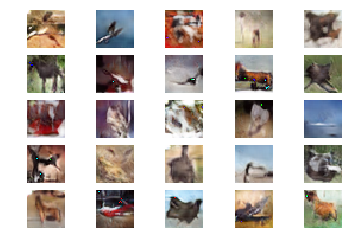

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 404 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.51, acc.: 78.85%] [G loss: 0.01]


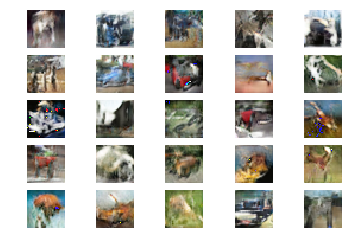

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 405 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.37, acc.: 82.60%] [G loss: 0.03]


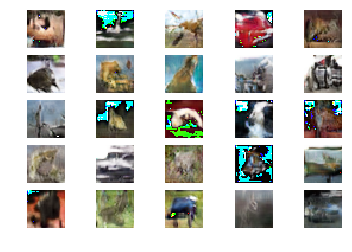

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 406 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.41, acc.: 90.21%] [G loss: 2.08]


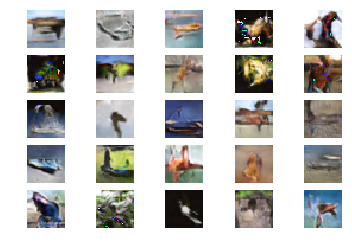

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 407 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.22, acc.: 93.33%] [G loss: 1.06]


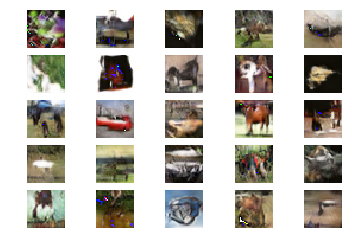

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 408 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.49, acc.: 69.48%] [G loss: 0.00]


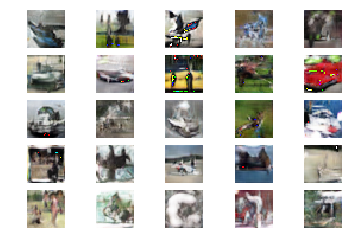

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 409 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.73, acc.: 60.10%] [G loss: 0.01]


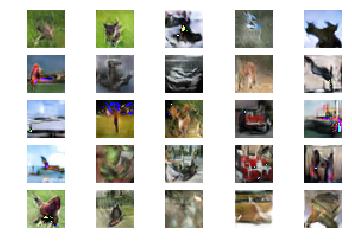

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 410 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.66, acc.: 68.33%] [G loss: 0.01]
Image grid result save.


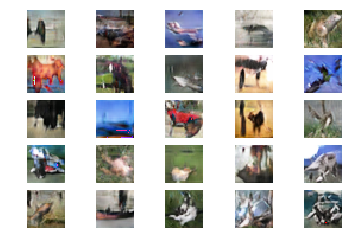

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 411 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.68, acc.: 67.08%] [G loss: 0.00]


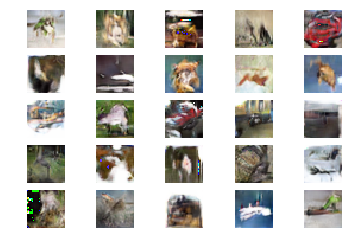

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 412 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.37, acc.: 87.08%] [G loss: 0.01]


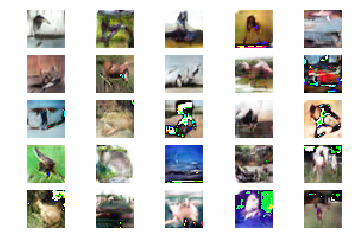

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 413 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.52, acc.: 71.04%] [G loss: 1.64]


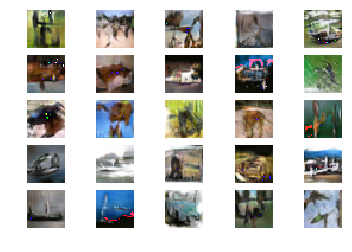

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 414 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.65, acc.: 59.90%] [G loss: 0.00]


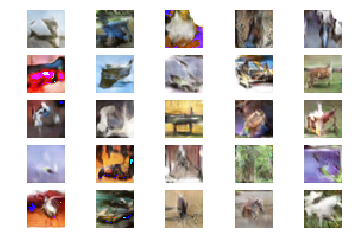

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 415 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.26, acc.: 90.62%] [G loss: 0.00]


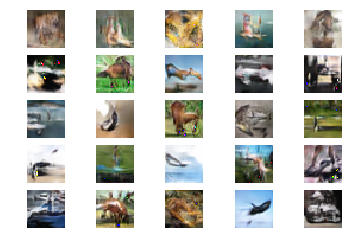

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 416 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.70, acc.: 56.98%] [G loss: 0.00]


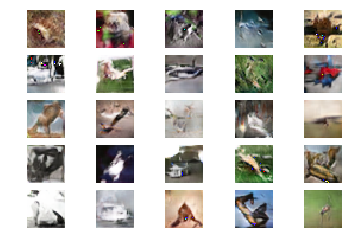

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 417 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.25, acc.: 91.77%] [G loss: 0.00]


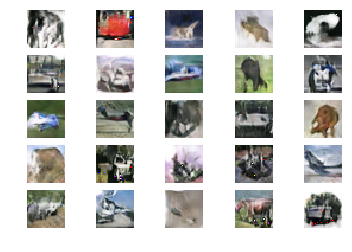

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 418 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.56, acc.: 80.62%] [G loss: 0.00]


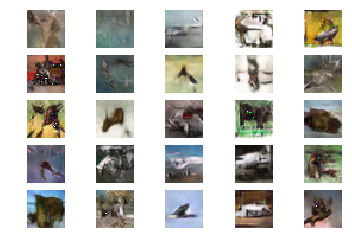

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 419 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.37, acc.: 83.75%] [G loss: 0.01]


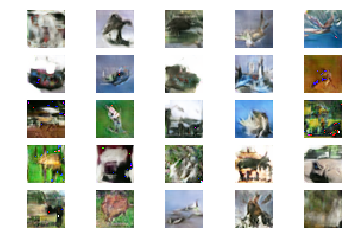

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 420 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.31, acc.: 90.62%] [G loss: 0.00]
Image grid result save.


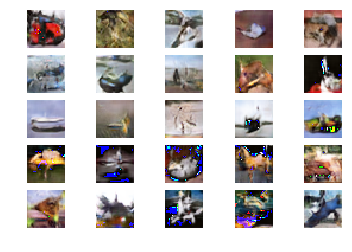

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 421 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.53, acc.: 69.48%] [G loss: 0.00]


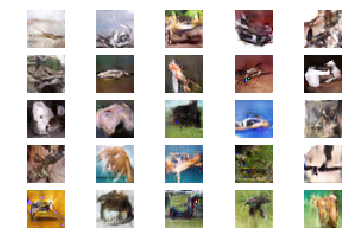

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 422 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.16, acc.: 96.88%] [G loss: 1.55]


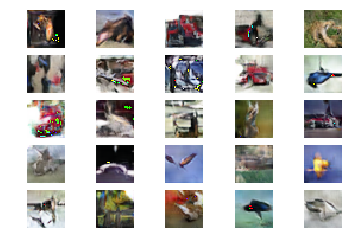

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 423 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.46, acc.: 87.29%] [G loss: 0.00]


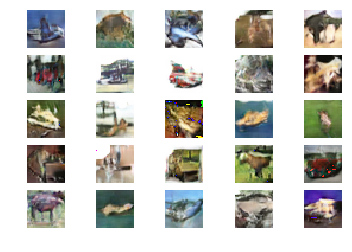

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 424 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.36 sec  - [D loss: 0.84, acc.: 56.04%] [G loss: 0.03]


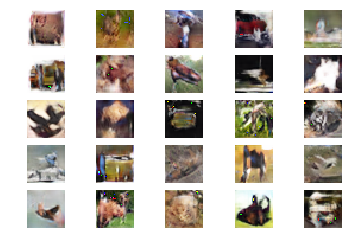

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 425 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.74, acc.: 61.46%] [G loss: 0.04]


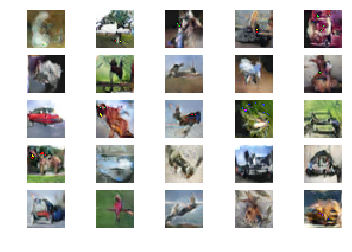

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 426 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.53, acc.: 75.00%] [G loss: 0.01]


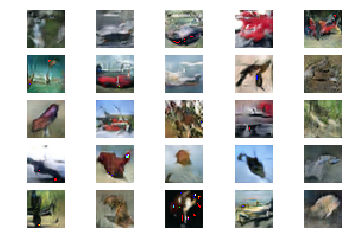

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 427 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.38, acc.: 83.54%] [G loss: 0.00]


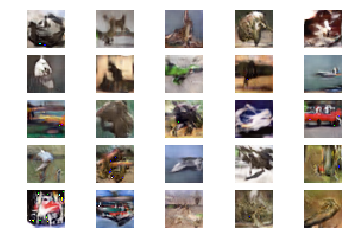

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 428 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.36, acc.: 82.60%] [G loss: 1.46]


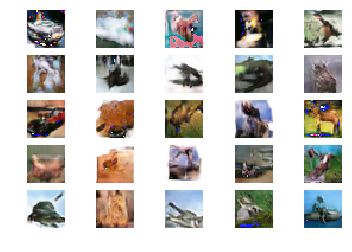

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 429 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.37, acc.: 90.62%] [G loss: 0.00]


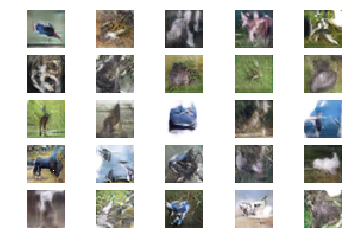

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 430 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.60, acc.: 66.15%] [G loss: 0.00]
Image grid result save.


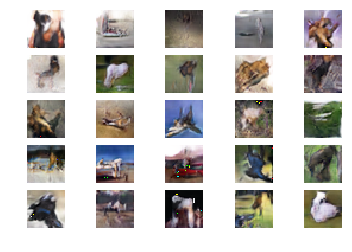

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 431 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.33, acc.: 88.65%] [G loss: 1.58]


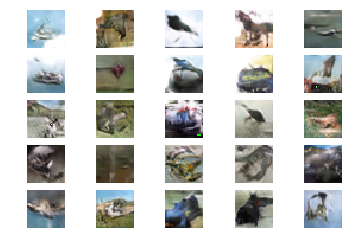

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 432 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.60, acc.: 74.58%] [G loss: 0.00]


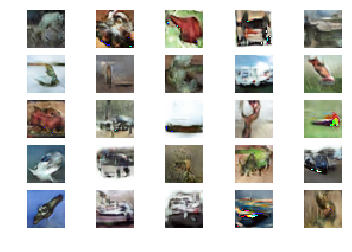

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 433 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.38, acc.: 87.50%] [G loss: 0.16]


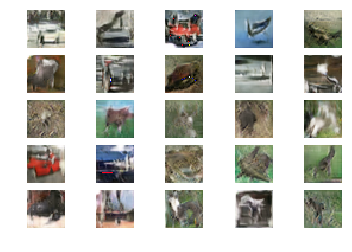

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 434 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.22, acc.: 93.33%] [G loss: 0.05]


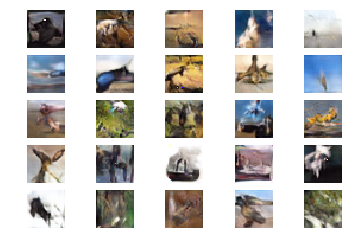

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 435 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.26, acc.: 95.10%] [G loss: 0.67]


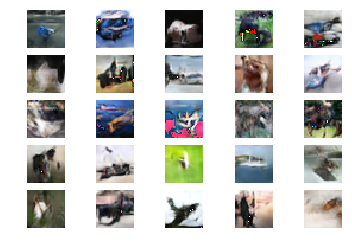

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 436 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.57, acc.: 70.63%] [G loss: 0.01]


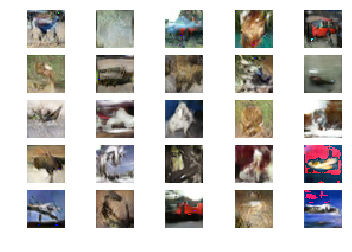

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 437 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.57 sec  - [D loss: 0.20, acc.: 90.62%] [G loss: 1.75]


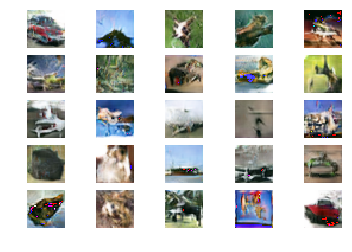

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 438 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.46 sec  - [D loss: 0.33, acc.: 82.60%] [G loss: 0.32]


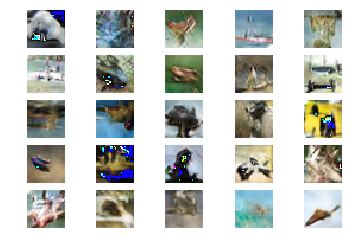

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 439 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.44, acc.: 76.15%] [G loss: 0.06]


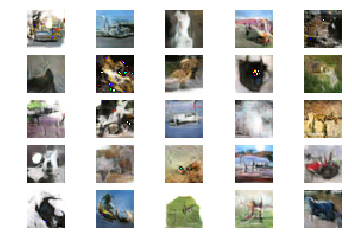

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 440 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.81, acc.: 61.87%] [G loss: 1.96]
Image grid result save.


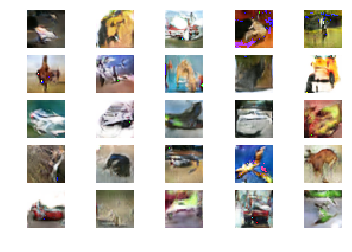

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 441 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.41 sec  - [D loss: 0.23, acc.: 96.67%] [G loss: 2.23]


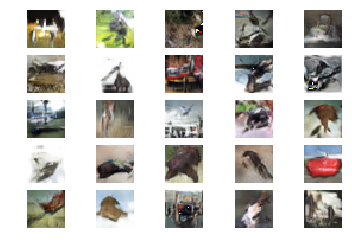

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 442 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.20, acc.: 93.33%] [G loss: 0.00]


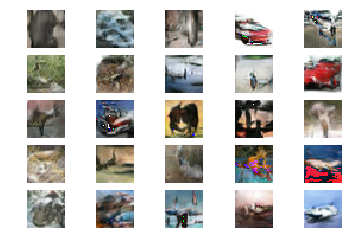

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 443 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.21 sec  - [D loss: 0.44, acc.: 77.08%] [G loss: 1.45]


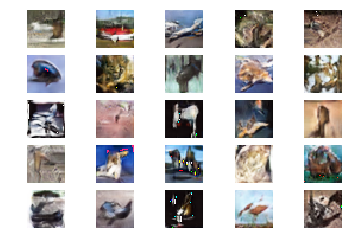

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 444 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.17, acc.: 95.31%] [G loss: 0.04]


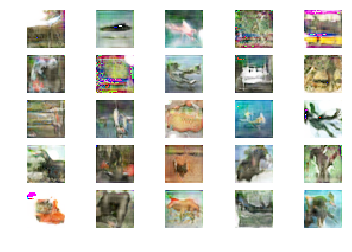

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 445 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.26 sec  - [D loss: 0.52, acc.: 74.58%] [G loss: 0.00]


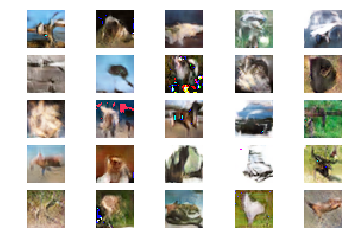

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 446 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.54, acc.: 72.19%] [G loss: 0.02]


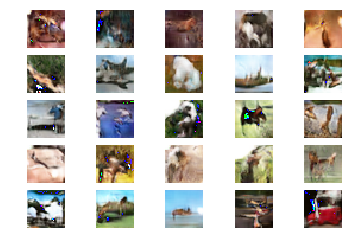

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 447 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.48, acc.: 75.73%] [G loss: 0.00]


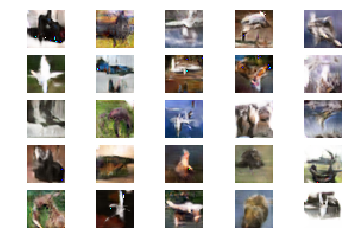

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 448 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.27 sec  - [D loss: 0.81, acc.: 53.65%] [G loss: 0.01]


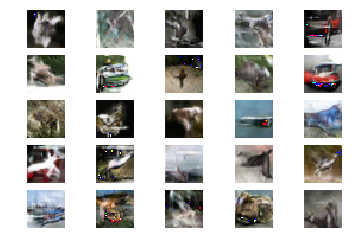

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 449 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.18 sec  - [D loss: 0.44, acc.: 76.15%] [G loss: 0.01]


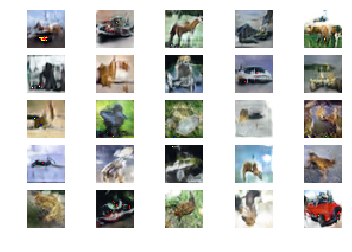

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 450 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.25 sec  - [D loss: 0.72, acc.: 70.10%] [G loss: 1.33]
Image grid result save.


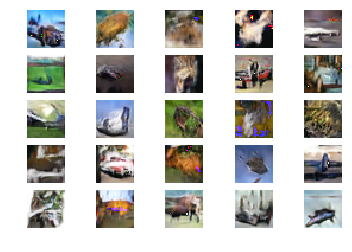

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 451 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.48, acc.: 79.06%] [G loss: 0.01]


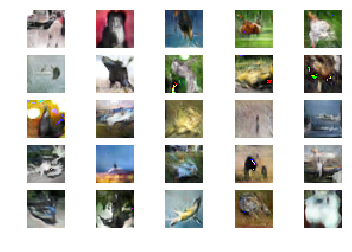

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 452 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.32, acc.: 88.65%] [G loss: 0.00]


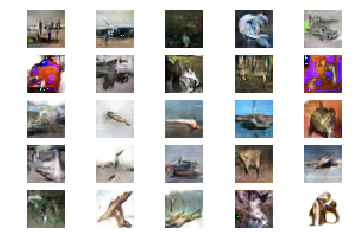

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 453 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.37, acc.: 76.88%] [G loss: 1.45]


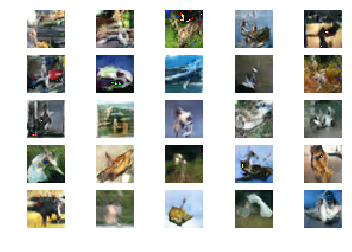

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 454 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.35 sec  - [D loss: 0.61, acc.: 75.31%] [G loss: 0.00]


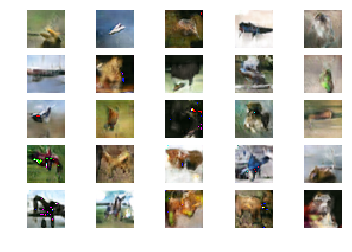

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 455 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.37, acc.: 85.31%] [G loss: 0.07]


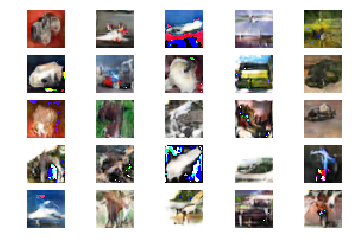

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 456 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.24 sec  - [D loss: 0.65, acc.: 68.75%] [G loss: 0.00]


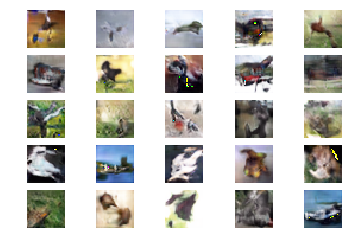

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 457 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.33, acc.: 85.52%] [G loss: 0.00]


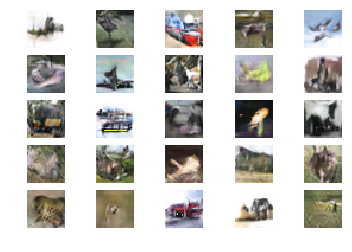

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 458 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.34 sec  - [D loss: 0.82, acc.: 53.23%] [G loss: 0.00]


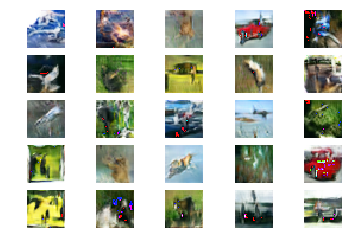

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 459 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.47 sec  - [D loss: 0.34, acc.: 92.19%] [G loss: 0.01]


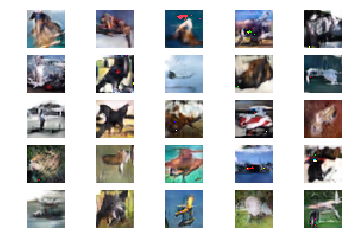

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 460 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.20, acc.: 95.31%] [G loss: 2.35]
Image grid result save.


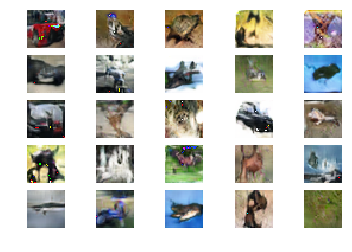

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 461 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.31, acc.: 90.42%] [G loss: 0.00]


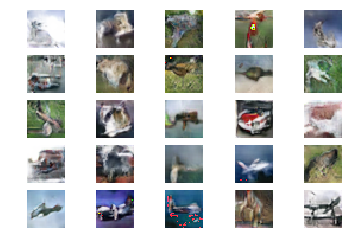

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 462 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.32 sec  - [D loss: 0.43, acc.: 73.75%] [G loss: 1.73]


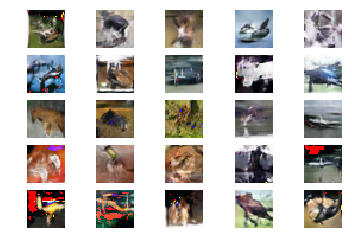

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 463 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.23 sec  - [D loss: 0.11, acc.: 100.00%] [G loss: 0.00]


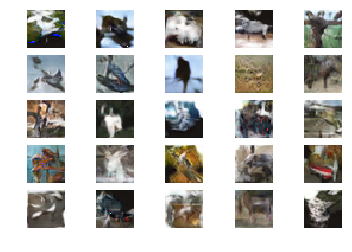

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 464 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.17 sec  - [D loss: 0.20, acc.: 95.31%] [G loss: 1.79]


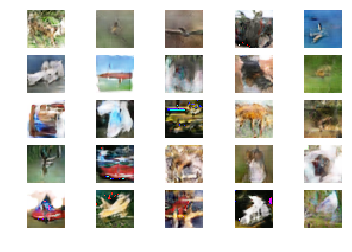

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 465 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.18 sec  - [D loss: 0.39, acc.: 81.98%] [G loss: 1.56]


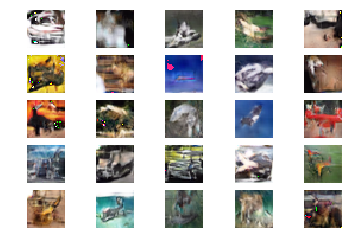

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 466 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 1.10, acc.: 48.75%] [G loss: 0.01]


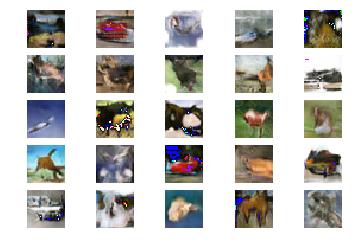

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 467 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.24 sec  - [D loss: 0.17, acc.: 96.88%] [G loss: 1.36]


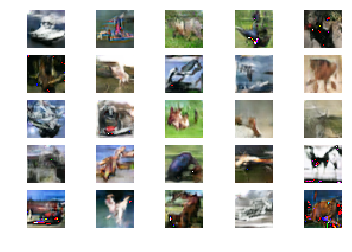

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 468 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.38, acc.: 87.29%] [G loss: 0.00]


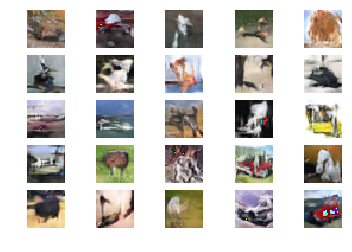

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 469 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.3 sec  - [D loss: 0.16, acc.: 93.75%] [G loss: 0.00]


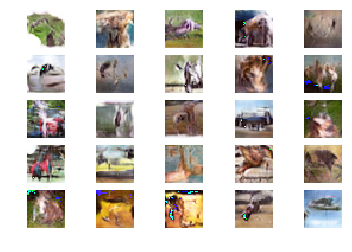

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 470 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.2 sec  - [D loss: 0.27, acc.: 90.62%] [G loss: 0.01]
Image grid result save.


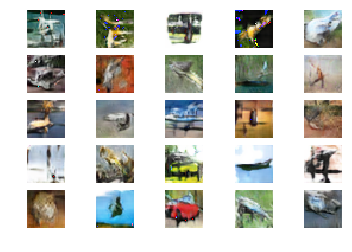

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 471 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.45 sec  - [D loss: 0.42, acc.: 81.04%] [G loss: 1.30]


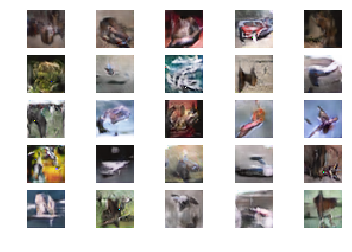

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 472 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.39 sec  - [D loss: 0.08, acc.: 98.44%] [G loss: 1.61]


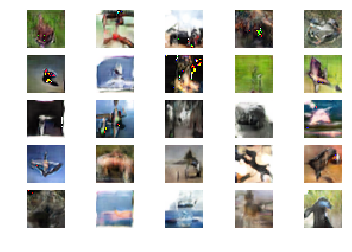

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 473 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.41, acc.: 76.56%] [G loss: 0.00]


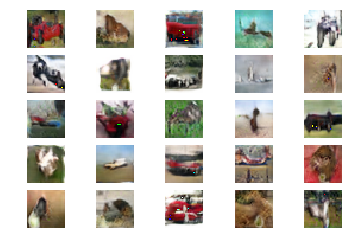

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 474 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.43 sec  - [D loss: 0.32, acc.: 88.65%] [G loss: 1.69]


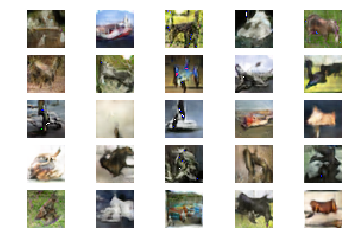

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 475 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.42 sec  - [D loss: 0.76, acc.: 67.50%] [G loss: 1.47]


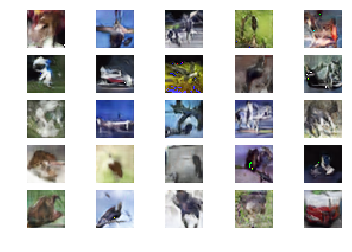

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 476 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.33 sec  - [D loss: 0.25, acc.: 93.54%] [G loss: 0.94]


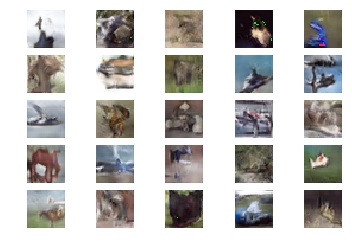

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 477 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.29 sec  - [D loss: 0.59, acc.: 69.48%] [G loss: 1.28]


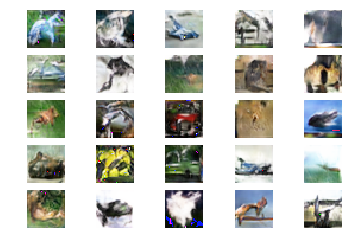

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 478 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.28 sec  - [D loss: 0.28, acc.: 83.96%] [G loss: 4.44]


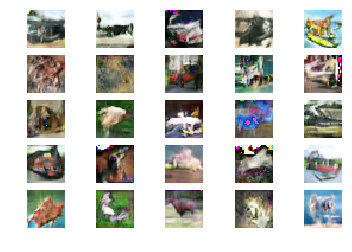

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 479 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.31 sec  - [D loss: 0.42, acc.: 80.62%] [G loss: 0.01]


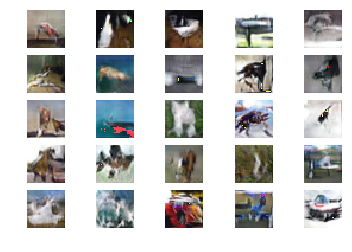

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 480 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.61, acc.: 76.88%] [G loss: 0.00]
Image grid result save.


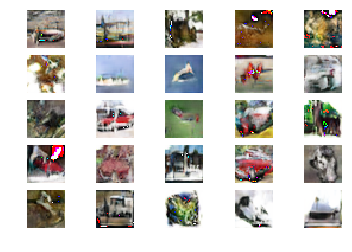

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 481 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.51 sec  - [D loss: 0.53, acc.: 77.92%] [G loss: 0.07]


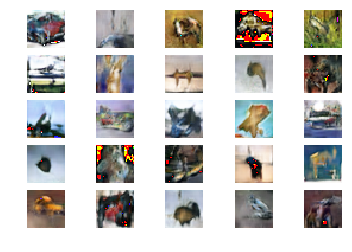

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 482 of 500000
1563/1562 [==============================] - 34s 21ms/step
Time 33.54 sec  - [D loss: 0.97, acc.: 43.02%] [G loss: 0.00]


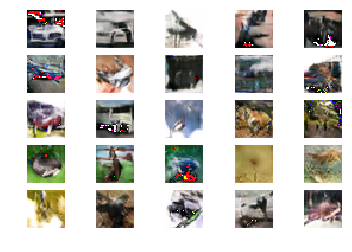

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 483 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.4 sec  - [D loss: 0.38, acc.: 84.17%] [G loss: 0.00]


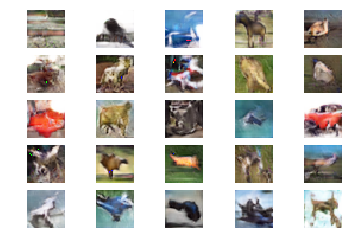

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 484 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.18 sec  - [D loss: 0.20, acc.: 95.31%] [G loss: 0.00]


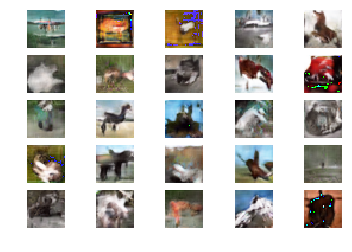

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 485 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.37 sec  - [D loss: 0.50, acc.: 72.60%] [G loss: 0.00]


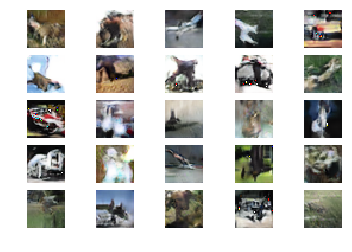

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 486 of 500000
1563/1562 [==============================] - 33s 21ms/step
Time 33.38 sec  - [D loss: 0.62, acc.: 75.00%] [G loss: 0.04]


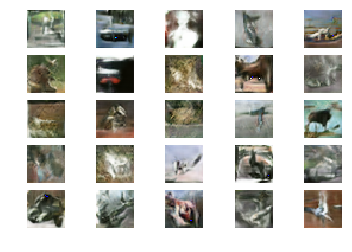

-----------------------------------------------------------------
-----------------------------------------------------------------
Epoch 487 of 500000
1288/1562 [=======================>......] - ETA: 5s

In [ ]:
model = DCGANModel()

model.compile_adversarial()
model.compile_discriminator()

trainer = GANTrainer(model, CIFARDataset(), NoiseDataset(), save_epoch_interval=10, preview_epoch=True, save_path="./result/CIFAR10_")
trainer.fit(epochs=500000, load_weight=True)

# model.save_discriminator('result/model_minist_dis_v1.h5')
# model.save_generator('result/model_minist_gen_v1.h5')